# Analyzing Government Service Requests in Miami-Dade County Via Unsupervised Learning 
## Unsupervised Learning Capstone Project

How should local government (counties) segment their constituents through their demands for public services? In this project, I am going to explore a dataset of service requests (for county-provided services) that Miami-Dade County residents made in 2019. I will be looking for trends and patterns among a number of important features measuring variation in constituents' socioeconomic statuses, community-level civic engagement, types of services requested, length of projects, and geography. If we can see how the data cluster together, we may gain insights as to how the county may improve their efficiency in certain areas or how the county allocates its resources across jurisdictions and across communities. The data are available at the county's open data portal [here](https://gis-mdc.opendata.arcgis.com/datasets/311-service-requests-miami-dade-county-2019). There are 319,855 records in the dataset and each row represents a service request made by a county resident. 

In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import statsmodels as sm

from scipy.stats import pointbiserialr
import scipy.stats as stats
import scipy.stats as ss
from scipy.stats.mstats import winsorize

from hyperopt import hp, tpe, fmin, Trials, STATUS_OK, space_eval

import time
from sklearn.datasets import fetch_openml
from sklearn.preprocessing import StandardScaler
from sklearn.mixture import GaussianMixture
from sklearn.cluster import AgglomerativeClustering
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.decomposition import PCA
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn import metrics
import umap


import warnings
%matplotlib inline

In [3]:
mdc = pd.read_csv('/users/machilders/Box Sync/Data Science/Thinkful/Data Files/311_Service_Requests__MiamiDade_County__2019.csv', index_col = 'ticket_id')

### Exploring the Data

In [4]:
mdc.head()

,issue_type,issue_description,case_owner,case_owner_description,street_address,city,state,zip_code,neighborhood_district,created_year_month,...,location_city,sr_xcoordinate,sr_ycoordinate,latitude,longitude,method_received,goal_days,actual_completed_days,ticket_year,ObjectId
ticket_id,,,,,,,,,,,,,,,,,,,,,
19-10000002,INJURED ANIMAL,,Enforcement_Section-3-36,Enforcement_Section-3-36,510 NE 159TH ST,Miami_Dade_County,Florida,33162.0,District 2,20191,...,MIAMI,922622.624,577785.497,25.920955,-80.189306,PHONE,180,0.0,2019,1
19-10000215,BULKY TRASH REQUEST,,Solid_Waste_Management,Solid Waste Management,26411 SW 134TH PL,Miami_Dade_County,Florida,33032.0,District 9,20191,...,MIAMI,850752.962,432240.669,25.521572,-80.409938,PHONE,8,8.0,2019,2
19-10000004,ASU POLICE ASSISTANCE,,Enforcement_Section-3-36,Enforcement_Section-3-36,SW 194TH TER & SW 87TH AVE,Town_of_Cutler_Bay,Florida,33157.0,District 8,20191,...,MIAMI,876363.436,455972.594,25.586534,-80.331919,INHOUSE,180,0.0,2019,3
19-10000216,GARBAGE COMPLAINT,,Solid_Waste_Management,Solid Waste Management,9130 SW 177TH TER,City_of_Palmetto_Bay,Florida,33157.0,District 8,20191,...,MIAMI,873625.435,462649.847,25.604943,-80.340125,PHONE,5,2.0,2019,4
19-10000228,COMMERCIAL VEHICLE - UNAUTHORIZED,,Regulatory_and_Economic_Resources,Regulatory and Economic Resources,3401 NW 110TH ST,Miami_Dade_County,Florida,33167.0,District 2,20191,...,MIAMI,901187.000,560754.000,25.874449,-80.254814,XTERFACE,120,6.0,2019,5


In [5]:
mdc.info()

<class 'pandas.core.frame.DataFrame'>
Index: 319855 entries, 19-10000002 to 19-10490440
Data columns (total 24 columns):
issue_type                       319855 non-null object
issue_description                319855 non-null object
case_owner                       319855 non-null object
case_owner_description           319855 non-null object
street_address                   319328 non-null object
city                             319136 non-null object
state                            319328 non-null object
zip_code                         319304 non-null float64
neighborhood_district            319855 non-null object
created_year_month               319855 non-null int64
ticket_created_date_time         319855 non-null object
ticket__last_update_date_time    319855 non-null object
ticket_closed_date_time          309740 non-null object
ticket_status                    319855 non-null object
location_city                    319855 non-null object
sr_xcoordinate                   318981

The county portal's landing page for the dataset does not provide a codebook or a legend to describe the columns, but thankfully most are self-explanatory. There are 24 columns and most are objects. The *issue_type* column provides the county's categorical code for the type of service request. *issue_description* has no data, but for some reason it does not show that it is missing any data. *case_owner* and *case_owner_description* tell us which county department provided the requested service. *goal_days* provides the county's target for the number of days in which to complete the service and *actual_completed_days* provides the number of days that it took to provide the service or complete the project. *neighborhood_district* probably refers to the county school board districts, as there are nine of them and there are nine labeled categories in the column. It cannot be measuring county commission districts because there are thirteen and there are many more than ten neighborhoods in Miami-Dade County (there are 34 municipalities alone and more than ten neighborhoods in the city of Miami itself).  

In [6]:
mdc.issue_type.value_counts()

BULKY TRASH REQUEST                                                  95384
GREEN WASTE CART REQUEST                                             50262
RECYCLING BLUE CART ISSUES                                           14398
ILLEGAL DUMPING - WM                                                 13253
GARBAGE COMPLAINT                                                    11101
MOSQUITO INSPECTION REQUEST                                          10777
PET ACCOUNT UPDATE                                                   10614
POTHOLE                                                               7181
JUNK AND TRASH / OVERGROWTH                                           6587
STRAY / DOG-AT-LARGE                                                  6462
DEAD ANIMAL PICKUP MD                                                 5652
RECYCLING COMPLAINT                                                   4910
COMMERCIAL VEHICLE - UNAUTHORIZED                                     4629
BULKY TRASH UPDATE       

In [7]:
mdc.case_owner_description.value_counts()

Solid Waste Management                          213968
Enforcement_Section-3-36                         31117
Regulatory and Economic Resources                27218
Public_Works_Road_And_Bridges-16-60              14508
Citations_and_Tags                               12516
RAAM-27-93                                        6551
Public_Works_Traffic_Engineering-10-60            4877
Public_Works_traffic_Signals_And_Signs-15-60      4822
COM_Code_Enforcement                              3710
Public_Works_Construction-6-60                     555
Public_Works_Right_Of_Way-4-60                      13
Name: case_owner_description, dtype: int64

In [8]:
mdc.neighborhood_district.nunique()

10

In [9]:
print("Percentage of each column's data that are missing:\n" )

mdc.isnull().sum()/mdc.isnull().count()*100

Percentage of each column's data that are missing:



issue_type                       0.000000
issue_description                0.000000
case_owner                       0.000000
case_owner_description           0.000000
street_address                   0.164762
city                             0.224789
state                            0.164762
zip_code                         0.172266
neighborhood_district            0.000000
created_year_month               0.000000
ticket_created_date_time         0.000000
ticket__last_update_date_time    0.000000
ticket_closed_date_time          3.162370
ticket_status                    0.000000
location_city                    0.000000
sr_xcoordinate                   0.273249
sr_ycoordinate                   0.273249
latitude                         0.273249
longitude                        0.273249
method_received                  0.000000
goal_days                        0.000000
actual_completed_days            3.162370
ticket_year                      0.000000
ObjectId                         0

There are very few rows with missing data. 10,115 (3.16%) rows are missing values on the ticket completion date (*ticket_closed_date_time*), which implies that those projects are either ongoing or the county failed to close out the tickets when they were completed. There also 551 (.17%) rows without zip codes data as well as hundreds of rows missing parts or all of the address of the person who made the initial county service request. Before I proceed to mitigate missing data for potentially important features, I am going to fill in missing data for zip codes because that allows us to integrate economic data like property tax payments and it provides a reasonable geographic unit to capture variation in other characteristics across the county. 

I am going merge tax payment data into this dataset because there is a common belief that local governments service affluent areas before they service others and property tax payments also capture income stratification. Zip codes are local geographical units that appear both in this dataset and in County tax roll records, making it easy to add it to this dataset.

In [10]:
mdc.neighborhood_district.value_counts()

District 1    129024
District 8     48507
District 9     39951
District 2     32830
District 7     23691
District 3     18537
District 6     13180
District 4      8264
District 5      4994
District         877
Name: neighborhood_district, dtype: int64

In [11]:
zipcodes = mdc.groupby('zip_code')['ObjectId'].count()

In [12]:
zipcodes

zip_code
0.0            2
33.0           1
331.0          1
3342.0         1
30310.0        1
33010.0      699
33012.0     1355
33013.0      668
33014.0     1939
33015.0     6788
33016.0     1707
33017.0        1
33018.0     2750
33030.0     4009
33031.0     2943
33032.0    10052
33033.0     7340
33034.0     1516
33035.0      460
33039.0        2
33054.0     7213
33055.0     8773
33056.0     7821
33101.0        5
33109.0        1
33116.0        2
33122.0      307
33125.0     1480
33126.0     1565
33127.0     1518
           ...  
33166.0     2178
33167.0     4516
33168.0     5094
33169.0     6756
33170.0     4376
33172.0     1295
33173.0     7184
33174.0     2931
33175.0    11050
33176.0    12905
33177.0    12156
33178.0     3831
33179.0     5693
33180.0     1917
33181.0      633
33182.0     2657
33183.0     6390
33184.0     3054
33185.0     5742
33186.0    12474
33187.0     5827
33189.0     4672
33190.0     1496
33193.0     5576
33194.0      823
33196.0     8569
33197.0        1
34141

There are a number of miscoded and incompletely coded zip codes. For example, some zip codes have values of 0, 33, 331, 3342, and 99999. 99999 is not a valid Miami-Dade zip code, for example. Most of erroneous or incomplete zip codes had other information that we can use to infer the correct zip code value, like house number, street name, or latitude and longitude of the property. Using Google Maps, I verified most of their to addresses and located the proper zip code values. 

The 99999 zip code appears to be a placeholder code for new developments that are not yet registered in the county's database. All 184 had street addresses in outlying areas of the county near the Everglades where there was very recent development. All of them were clustered together on the same street and shared the same postal code.

In [13]:
mdc[mdc['zip_code'] == 0]

,issue_type,issue_description,case_owner,case_owner_description,street_address,city,state,zip_code,neighborhood_district,created_year_month,...,location_city,sr_xcoordinate,sr_ycoordinate,latitude,longitude,method_received,goal_days,actual_completed_days,ticket_year,ObjectId
ticket_id,,,,,,,,,,,,,,,,,,,,,
19-10191363,JUNK AND TRASH / OVERGROWTH,,Regulatory_and_Economic_Resources,Regulatory and Economic Resources,15111 NE 5TH AVE (APPROX),Miami_Dade_County,Florida,0.0,District 2,20195,...,MIAMI,922604.200000,575301.80000,25.914123,-80.189409,OTHER,90,33.0,2019,124103
19-10470868,DEAD ANIMAL PICKUP MD,,Enforcement_Section-3-36,Enforcement_Section-3-36,12089 sw 152nd st,NaN,Florida,0.0,District 9,201912,...,MIAMI,857776.006179,470939.52932,25.627960,-80.388102,WEB,180,3.0,2019,306688


In [14]:
#sipp2008w2_all.loc[sipp2008w2_all['tfipsst'] == 6, 'state'] = 1

mdc.loc[mdc['ObjectId'] == 124103, 'zip_code' ] = 33162

In [15]:
mdc.loc[mdc['ObjectId'] == 306688, 'zip_code' ] = 33177

In [16]:
mdc[mdc['zip_code'] == 33]

,issue_type,issue_description,case_owner,case_owner_description,street_address,city,state,zip_code,neighborhood_district,created_year_month,...,location_city,sr_xcoordinate,sr_ycoordinate,latitude,longitude,method_received,goal_days,actual_completed_days,ticket_year,ObjectId
ticket_id,,,,,,,,,,,,,,,,,,,,,
19-10371708,BULKY TRASH REQUEST,,Solid_Waste_Management,Solid Waste Management,6804 SW 145 TERR,NaN,Florida,33.0,District 8,20199,...,MIAMI,885652.522703,473938.519741,25.635832,-80.303451,WEB,8,5.0,2019,242868


In [17]:
mdc.loc[mdc['ObjectId'] == 242868, 'zip_code'] = 33158

In [18]:
mdc[mdc['zip_code'] == 331]

,issue_type,issue_description,case_owner,case_owner_description,street_address,city,state,zip_code,neighborhood_district,created_year_month,...,location_city,sr_xcoordinate,sr_ycoordinate,latitude,longitude,method_received,goal_days,actual_completed_days,ticket_year,ObjectId
ticket_id,,,,,,,,,,,,,,,,,,,,,
19-10407575,ILLEGAL DUMPING - WM,,Solid_Waste_Management,Solid Waste Management,17525 NW 7th AVE,NaN,Florida,331.0,District 1,201910,...,MIAMI,NaN,NaN,NaN,NaN,WEB,90,1.0,2019,265607


In [19]:
mdc.loc[mdc['ObjectId'] == 265607, 'zip_code'] = 33169

In [20]:
mdc[mdc['zip_code'] == 3342]

,issue_type,issue_description,case_owner,case_owner_description,street_address,city,state,zip_code,neighborhood_district,created_year_month,...,location_city,sr_xcoordinate,sr_ycoordinate,latitude,longitude,method_received,goal_days,actual_completed_days,ticket_year,ObjectId
ticket_id,,,,,,,,,,,,,,,,,,,,,
19-10094493,GREEN WASTE CART REQUEST,,Solid_Waste_Management,Solid Waste Management,12043 SW 216TH ST,Miami_Dade_County,Florida,3342.0,District 9,20193,...,MIAMI,858205.573,448519.063,25.566267,-80.387113,PHONE,10,9.0,2019,61101


In [21]:
mdc.loc[mdc['ObjectId'] == 61101, 'zip_code'] = 33170

In [22]:
mdc[mdc['zip_code'] == 30310]

,issue_type,issue_description,case_owner,case_owner_description,street_address,city,state,zip_code,neighborhood_district,created_year_month,...,location_city,sr_xcoordinate,sr_ycoordinate,latitude,longitude,method_received,goal_days,actual_completed_days,ticket_year,ObjectId
ticket_id,,,,,,,,,,,,,,,,,,,,,
19-10191361,JUNK AND TRASH / OVERGROWTH,,Regulatory_and_Economic_Resources,Regulatory and Economic Resources,14040 NW 7TH AVE,Miami_Dade_County,Florida,30310.0,District 2,20195,...,MIAMI,915264.81,571218.499,25.903012,-80.211811,OTHER,90,0.0,2019,124088


In [23]:
mdc.loc[mdc['ObjectId'] == 124088, 'zip_code'] = 33168

In [24]:
mdc[mdc['zip_code'] == 85282]

,issue_type,issue_description,case_owner,case_owner_description,street_address,city,state,zip_code,neighborhood_district,created_year_month,...,location_city,sr_xcoordinate,sr_ycoordinate,latitude,longitude,method_received,goal_days,actual_completed_days,ticket_year,ObjectId
ticket_id,,,,,,,,,,,,,,,,,,,,,
19-10321771,GREEN WASTE CART REQUEST,,Solid_Waste_Management,Solid Waste Management,3425 s Priste dr,City_of_Miami_Lakes,Florida,85282.0,District 1,20198,...,MIAMI,875123.936,572989.249,25.908496,-80.333887,PHONE,10,11.0,2019,210537
19-10321774,RECYCLING BLUE CART ISSUES,,Solid_Waste_Management,Solid Waste Management,3425 s Priste dr,City_of_Miami_Lakes,Florida,85282.0,District 1,20198,...,MIAMI,875123.936,572989.249,25.908496,-80.333887,PHONE,10,14.0,2019,210556


In [25]:
mdc.loc[mdc['ObjectId'] == 210537, 'zip_code'] = 33016


mdc.loc[mdc['ObjectId'] == 210556, 'zip_code'] = 33016

In [26]:
zipsmissing = mdc[mdc['zip_code'] == 99999]

In [27]:
zipsmissing.to_csv('/Users/machilders/Box Sync/Data Science/Thinkful/Data Files/zipsmissing.csv')

In [28]:
mdc.loc[mdc['zip_code'] == 99999, 'zip_code'] = 33030

I exported the rows that had missing zip codes to a CSV file and manually searched for their postal codes on Google Maps. As I have already discussed, many of them either had house numbers and street names or latitude and longitude values. That was enough for me to locate their locations and complete addresses on Google Maps. 

In [29]:
zipsmissing = mdc[mdc['zip_code'].isnull()]

In [30]:
zipsmissing.to_csv('/Users/machilders/Box Sync/Data Science/Thinkful/Data Files/zipsmissing.csv')

In [31]:
mdc.loc[mdc['ObjectId'] ==  15771, 'zip_code'] = 33196
mdc.loc[mdc['ObjectId'] ==  15822, 'zip_code'] = 33196
mdc.loc[mdc['ObjectId'] ==  13222, 'zip_code'] = 33196
mdc.loc[mdc['ObjectId'] ==  13378, 'zip_code'] = 33196
mdc.loc[mdc['ObjectId'] ==  154560, 'zip_code'] = 33196
mdc.loc[mdc['ObjectId'] ==  175680, 'zip_code'] = 33196
mdc.loc[mdc['ObjectId'] ==  206191, 'zip_code'] = 33196
mdc.loc[mdc['ObjectId'] ==  303328, 'zip_code'] = 33196
mdc.loc[mdc['ObjectId'] ==  305116, 'zip_code'] = 33196
mdc.loc[mdc['ObjectId'] ==  318428, 'zip_code'] = 33196
mdc.loc[mdc['ObjectId'] ==  318898, 'zip_code'] = 33196
mdc.loc[mdc['ObjectId'] ==  153350, 'zip_code'] = 33194
mdc.loc[mdc['ObjectId'] ==  234542, 'zip_code'] = 33194
mdc.loc[mdc['ObjectId'] ==  62762, 'zip_code'] = 33193
mdc.loc[mdc['ObjectId'] ==  71691, 'zip_code'] = 33193
mdc.loc[mdc['ObjectId'] ==  122740, 'zip_code'] = 33193
mdc.loc[mdc['ObjectId'] ==  283371, 'zip_code'] = 33193
mdc.loc[mdc['ObjectId'] ==  51150, 'zip_code'] = 33190
mdc.loc[mdc['ObjectId'] ==  27442, 'zip_code'] = 33189
mdc.loc[mdc['ObjectId'] ==  27457, 'zip_code'] = 33189
mdc.loc[mdc['ObjectId'] ==  90011, 'zip_code'] = 33189
mdc.loc[mdc['ObjectId'] ==  82565, 'zip_code'] = 33187
mdc.loc[mdc['ObjectId'] ==  101646, 'zip_code'] = 33187
mdc.loc[mdc['ObjectId'] ==  157013, 'zip_code'] = 33187
mdc.loc[mdc['ObjectId'] ==  177500, 'zip_code'] = 33187
mdc.loc[mdc['ObjectId'] ==  202871, 'zip_code'] = 33187
mdc.loc[mdc['ObjectId'] ==  315618, 'zip_code'] = 33187
mdc.loc[mdc['ObjectId'] ==  310721, 'zip_code'] = 33187
mdc.loc[mdc['ObjectId'] ==  74394, 'zip_code'] = 33186
mdc.loc[mdc['ObjectId'] ==  84180, 'zip_code'] = 33186
mdc.loc[mdc['ObjectId'] ==  93094, 'zip_code'] = 33186
mdc.loc[mdc['ObjectId'] ==  207112, 'zip_code'] = 33186
mdc.loc[mdc['ObjectId'] ==  206486, 'zip_code'] = 33186
mdc.loc[mdc['ObjectId'] ==  233931, 'zip_code'] = 33186
mdc.loc[mdc['ObjectId'] ==  249536, 'zip_code'] = 33186
mdc.loc[mdc['ObjectId'] ==  2969, 'zip_code'] = 33185
mdc.loc[mdc['ObjectId'] ==  14887, 'zip_code'] = 33185
mdc.loc[mdc['ObjectId'] ==  35725, 'zip_code'] = 33185
mdc.loc[mdc['ObjectId'] ==  98910, 'zip_code'] = 33185
mdc.loc[mdc['ObjectId'] ==  124404, 'zip_code'] = 33185
mdc.loc[mdc['ObjectId'] ==  142174, 'zip_code'] = 33185
mdc.loc[mdc['ObjectId'] ==  143770, 'zip_code'] = 33185
mdc.loc[mdc['ObjectId'] ==  250584, 'zip_code'] = 33185
mdc.loc[mdc['ObjectId'] ==  266368, 'zip_code'] = 33185
mdc.loc[mdc['ObjectId'] ==  278827, 'zip_code'] = 33185
mdc.loc[mdc['ObjectId'] ==  875, 'zip_code'] = 33184
mdc.loc[mdc['ObjectId'] ==  963, 'zip_code'] = 33184
mdc.loc[mdc['ObjectId'] ==  5355, 'zip_code'] = 33184
mdc.loc[mdc['ObjectId'] ==  37788, 'zip_code'] = 33184
mdc.loc[mdc['ObjectId'] ==  46935, 'zip_code'] = 33184
mdc.loc[mdc['ObjectId'] ==  46937, 'zip_code'] = 33184
mdc.loc[mdc['ObjectId'] ==  61085, 'zip_code'] = 33184
mdc.loc[mdc['ObjectId'] ==  103002, 'zip_code'] = 33184
mdc.loc[mdc['ObjectId'] ==  139385, 'zip_code'] = 33184
mdc.loc[mdc['ObjectId'] ==  139502, 'zip_code'] = 33184
mdc.loc[mdc['ObjectId'] ==  191126, 'zip_code'] = 33184
mdc.loc[mdc['ObjectId'] ==  211376, 'zip_code'] = 33184
mdc.loc[mdc['ObjectId'] ==  231818, 'zip_code'] = 33184
mdc.loc[mdc['ObjectId'] ==  240343, 'zip_code'] = 33184
mdc.loc[mdc['ObjectId'] ==  291359, 'zip_code'] = 33184
mdc.loc[mdc['ObjectId'] ==  90188, 'zip_code'] = 33183
mdc.loc[mdc['ObjectId'] ==  148039, 'zip_code'] = 33182
mdc.loc[mdc['ObjectId'] ==  207308, 'zip_code'] = 33182
mdc.loc[mdc['ObjectId'] ==  227234, 'zip_code'] = 33182
mdc.loc[mdc['ObjectId'] ==  237182, 'zip_code'] = 33182
mdc.loc[mdc['ObjectId'] ==  283830, 'zip_code'] = 33182
mdc.loc[mdc['ObjectId'] ==  225994, 'zip_code'] = 33181
mdc.loc[mdc['ObjectId'] ==  296543, 'zip_code'] = 33181
mdc.loc[mdc['ObjectId'] ==  135858, 'zip_code'] = 33180
mdc.loc[mdc['ObjectId'] ==  135890, 'zip_code'] = 33180
mdc.loc[mdc['ObjectId'] ==  145404, 'zip_code'] = 33180
mdc.loc[mdc['ObjectId'] ==  190217, 'zip_code'] = 33180
mdc.loc[mdc['ObjectId'] ==  227276, 'zip_code'] = 33180
mdc.loc[mdc['ObjectId'] ==  314584, 'zip_code'] = 33180
mdc.loc[mdc['ObjectId'] ==  54925, 'zip_code'] = 33179
mdc.loc[mdc['ObjectId'] ==  179759, 'zip_code'] = 33179
mdc.loc[mdc['ObjectId'] ==  265801, 'zip_code'] = 33179
mdc.loc[mdc['ObjectId'] ==  111374, 'zip_code'] = 33177
mdc.loc[mdc['ObjectId'] ==  111376, 'zip_code'] = 33177
mdc.loc[mdc['ObjectId'] ==  157479, 'zip_code'] = 33177
mdc.loc[mdc['ObjectId'] ==  157560, 'zip_code'] = 33177
mdc.loc[mdc['ObjectId'] ==  248741, 'zip_code'] = 33177
mdc.loc[mdc['ObjectId'] ==  260384, 'zip_code'] = 33177
mdc.loc[mdc['ObjectId'] ==  282491, 'zip_code'] = 33177
mdc.loc[mdc['ObjectId'] ==  89727, 'zip_code'] = 33176
mdc.loc[mdc['ObjectId'] ==  213953, 'zip_code'] = 33176
mdc.loc[mdc['ObjectId'] ==  228372, 'zip_code'] = 33176
mdc.loc[mdc['ObjectId'] ==  274640, 'zip_code'] = 33176
mdc.loc[mdc['ObjectId'] ==  294735, 'zip_code'] = 33176
mdc.loc[mdc['ObjectId'] ==  275843, 'zip_code'] = 33176
mdc.loc[mdc['ObjectId'] ==  317343, 'zip_code'] = 33176
mdc.loc[mdc['ObjectId'] ==  4857, 'zip_code'] = 33175
mdc.loc[mdc['ObjectId'] ==  5146, 'zip_code'] = 33175
mdc.loc[mdc['ObjectId'] ==  36397, 'zip_code'] = 33175
mdc.loc[mdc['ObjectId'] ==  67661, 'zip_code'] = 33175
mdc.loc[mdc['ObjectId'] ==  130509, 'zip_code'] = 33175
mdc.loc[mdc['ObjectId'] ==  296775, 'zip_code'] = 33175
mdc.loc[mdc['ObjectId'] ==  297441, 'zip_code'] = 33175
mdc.loc[mdc['ObjectId'] ==  4095, 'zip_code'] = 33174
mdc.loc[mdc['ObjectId'] ==  5718, 'zip_code'] = 33173
mdc.loc[mdc['ObjectId'] ==  63740, 'zip_code'] = 33173
mdc.loc[mdc['ObjectId'] ==  116135, 'zip_code'] = 33173
mdc.loc[mdc['ObjectId'] ==  249655, 'zip_code'] = 33173
mdc.loc[mdc['ObjectId'] ==  278922, 'zip_code'] = 33173
mdc.loc[mdc['ObjectId'] ==  58562, 'zip_code'] = 33172
mdc.loc[mdc['ObjectId'] ==  160111, 'zip_code'] = 33172
mdc.loc[mdc['ObjectId'] ==  92133, 'zip_code'] = 33171
mdc.loc[mdc['ObjectId'] ==  7800, 'zip_code'] = 33170
mdc.loc[mdc['ObjectId'] ==  264329, 'zip_code'] = 33170
mdc.loc[mdc['ObjectId'] ==  264334, 'zip_code'] = 33170
mdc.loc[mdc['ObjectId'] ==  100274, 'zip_code'] = 33169
mdc.loc[mdc['ObjectId'] ==  111286, 'zip_code'] = 33169
mdc.loc[mdc['ObjectId'] ==  154597, 'zip_code'] = 33169
mdc.loc[mdc['ObjectId'] ==  254311, 'zip_code'] = 33169
mdc.loc[mdc['ObjectId'] ==  84274, 'zip_code'] = 33167
mdc.loc[mdc['ObjectId'] ==  108497, 'zip_code'] = 33167
mdc.loc[mdc['ObjectId'] ==  109390, 'zip_code'] = 33167
mdc.loc[mdc['ObjectId'] ==  148646, 'zip_code'] = 33167
mdc.loc[mdc['ObjectId'] ==  191332, 'zip_code'] = 33167
mdc.loc[mdc['ObjectId'] ==  203577, 'zip_code'] = 33167
mdc.loc[mdc['ObjectId'] ==  290682, 'zip_code'] = 33167
mdc.loc[mdc['ObjectId'] ==  9080, 'zip_code'] = 33166
mdc.loc[mdc['ObjectId'] ==  17120, 'zip_code'] = 33166
mdc.loc[mdc['ObjectId'] ==  14867, 'zip_code'] = 33166
mdc.loc[mdc['ObjectId'] ==  25549, 'zip_code'] = 33166
mdc.loc[mdc['ObjectId'] ==  31505, 'zip_code'] = 33166
mdc.loc[mdc['ObjectId'] ==  37963, 'zip_code'] = 33166
mdc.loc[mdc['ObjectId'] ==  101558, 'zip_code'] = 33166
mdc.loc[mdc['ObjectId'] ==  109374, 'zip_code'] = 33166
mdc.loc[mdc['ObjectId'] ==  177165, 'zip_code'] = 33166
mdc.loc[mdc['ObjectId'] ==  249289, 'zip_code'] = 33165
mdc.loc[mdc['ObjectId'] ==  316669, 'zip_code'] = 33165
mdc.loc[mdc['ObjectId'] ==  179417, 'zip_code'] = 33162
mdc.loc[mdc['ObjectId'] ==  254328, 'zip_code'] = 33162
mdc.loc[mdc['ObjectId'] ==  250371, 'zip_code'] = 33160
mdc.loc[mdc['ObjectId'] ==  124953, 'zip_code'] = 33157
mdc.loc[mdc['ObjectId'] ==  285477, 'zip_code'] = 33157
mdc.loc[mdc['ObjectId'] ==  44590, 'zip_code'] = 33156
mdc.loc[mdc['ObjectId'] ==  108560, 'zip_code'] = 33156
mdc.loc[mdc['ObjectId'] ==  150408, 'zip_code'] = 33156
mdc.loc[mdc['ObjectId'] ==  180425, 'zip_code'] = 33156
mdc.loc[mdc['ObjectId'] ==  227949, 'zip_code'] = 33156
mdc.loc[mdc['ObjectId'] ==  225493, 'zip_code'] = 33156
mdc.loc[mdc['ObjectId'] ==  230496, 'zip_code'] = 33156
mdc.loc[mdc['ObjectId'] ==  238274, 'zip_code'] = 33156
mdc.loc[mdc['ObjectId'] ==  90205, 'zip_code'] = 33155
mdc.loc[mdc['ObjectId'] ==  177634, 'zip_code'] = 33155
mdc.loc[mdc['ObjectId'] ==  224079, 'zip_code'] = 33155
mdc.loc[mdc['ObjectId'] ==  290953, 'zip_code'] = 33155
mdc.loc[mdc['ObjectId'] ==  119747, 'zip_code'] = 33154
mdc.loc[mdc['ObjectId'] ==  120900, 'zip_code'] = 33154
mdc.loc[mdc['ObjectId'] ==  122226, 'zip_code'] = 33154
mdc.loc[mdc['ObjectId'] ==  138027, 'zip_code'] = 33154
mdc.loc[mdc['ObjectId'] ==  153300, 'zip_code'] = 33154
mdc.loc[mdc['ObjectId'] ==  151934, 'zip_code'] = 33154
mdc.loc[mdc['ObjectId'] ==  194594, 'zip_code'] = 33154
mdc.loc[mdc['ObjectId'] ==  194600, 'zip_code'] = 33154
mdc.loc[mdc['ObjectId'] ==  230829, 'zip_code'] = 33154
mdc.loc[mdc['ObjectId'] ==  66957, 'zip_code'] = 33147
mdc.loc[mdc['ObjectId'] ==  106817, 'zip_code'] = 33147
mdc.loc[mdc['ObjectId'] ==  162899, 'zip_code'] = 33145
mdc.loc[mdc['ObjectId'] ==  162950, 'zip_code'] = 33145
mdc.loc[mdc['ObjectId'] ==  209190, 'zip_code'] = 33144
mdc.loc[mdc['ObjectId'] ==  13125, 'zip_code'] = 33143
mdc.loc[mdc['ObjectId'] ==  284451, 'zip_code'] = 33143
mdc.loc[mdc['ObjectId'] ==  19208, 'zip_code'] = 33142
mdc.loc[mdc['ObjectId'] ==  19220, 'zip_code'] = 33142
mdc.loc[mdc['ObjectId'] ==  19593, 'zip_code'] = 33142
mdc.loc[mdc['ObjectId'] ==  24362, 'zip_code'] = 33142
mdc.loc[mdc['ObjectId'] ==  38509, 'zip_code'] = 33142
mdc.loc[mdc['ObjectId'] ==  227595, 'zip_code'] = 33141
mdc.loc[mdc['ObjectId'] ==  245211, 'zip_code'] = 33141
mdc.loc[mdc['ObjectId'] ==  306045, 'zip_code'] = 33141
mdc.loc[mdc['ObjectId'] ==  252615, 'zip_code'] = 33137
mdc.loc[mdc['ObjectId'] ==  98882, 'zip_code'] = 33136
mdc.loc[mdc['ObjectId'] ==  154783, 'zip_code'] = 33134
mdc.loc[mdc['ObjectId'] ==  118255, 'zip_code'] = 33132
mdc.loc[mdc['ObjectId'] ==  194951, 'zip_code'] = 33132
mdc.loc[mdc['ObjectId'] ==  304131, 'zip_code'] = 33132
mdc.loc[mdc['ObjectId'] ==  115221, 'zip_code'] = 33130
mdc.loc[mdc['ObjectId'] ==  213920, 'zip_code'] = 33127
mdc.loc[mdc['ObjectId'] ==  197290, 'zip_code'] = 33125
mdc.loc[mdc['ObjectId'] ==  186837, 'zip_code'] = 33122
mdc.loc[mdc['ObjectId'] ==  34032, 'zip_code'] = 33054
mdc.loc[mdc['ObjectId'] ==  89806, 'zip_code'] = 33054
mdc.loc[mdc['ObjectId'] ==  104157, 'zip_code'] = 33033
mdc.loc[mdc['ObjectId'] ==  124235, 'zip_code'] = 33033
mdc.loc[mdc['ObjectId'] ==  251193, 'zip_code'] = 33033
mdc.loc[mdc['ObjectId'] ==  83315, 'zip_code'] = 33032
mdc.loc[mdc['ObjectId'] ==  109529, 'zip_code'] = 33032
mdc.loc[mdc['ObjectId'] ==  88867, 'zip_code'] = 33032
mdc.loc[mdc['ObjectId'] ==  222371, 'zip_code'] = 33032
mdc.loc[mdc['ObjectId'] ==  239410, 'zip_code'] = 33032
mdc.loc[mdc['ObjectId'] ==  246233, 'zip_code'] = 33032
mdc.loc[mdc['ObjectId'] ==  287364, 'zip_code'] = 33032
mdc.loc[mdc['ObjectId'] ==  287802, 'zip_code'] = 33032
mdc.loc[mdc['ObjectId'] ==  6070, 'zip_code'] = 33031
mdc.loc[mdc['ObjectId'] ==  33028, 'zip_code'] = 33031
mdc.loc[mdc['ObjectId'] ==  33047, 'zip_code'] = 33031
mdc.loc[mdc['ObjectId'] ==  53003, 'zip_code'] = 33031
mdc.loc[mdc['ObjectId'] ==  67715, 'zip_code'] = 33031
mdc.loc[mdc['ObjectId'] ==  67737, 'zip_code'] = 33031
mdc.loc[mdc['ObjectId'] ==  192277, 'zip_code'] = 33031
mdc.loc[mdc['ObjectId'] ==  192178, 'zip_code'] = 33030
mdc.loc[mdc['ObjectId'] ==  85755, 'zip_code'] = 33018
mdc.loc[mdc['ObjectId'] ==  94873, 'zip_code'] = 33018
mdc.loc[mdc['ObjectId'] ==  125601, 'zip_code'] = 33018
mdc.loc[mdc['ObjectId'] ==  125609, 'zip_code'] = 33018
mdc.loc[mdc['ObjectId'] ==  125900, 'zip_code'] = 33018
mdc.loc[mdc['ObjectId'] ==  202278, 'zip_code'] = 33018
mdc.loc[mdc['ObjectId'] ==  254752, 'zip_code'] = 33018
mdc.loc[mdc['ObjectId'] ==  254772, 'zip_code'] = 33018
mdc.loc[mdc['ObjectId'] ==  271065, 'zip_code'] = 33018
mdc.loc[mdc['ObjectId'] ==  303802, 'zip_code'] = 33018
mdc.loc[mdc['ObjectId'] ==  146361, 'zip_code'] = 33016
mdc.loc[mdc['ObjectId'] ==  243119, 'zip_code'] = 33015
mdc.loc[mdc['ObjectId'] ==  105859, 'zip_code'] = 33014
mdc.loc[mdc['ObjectId'] ==  90167, 'zip_code'] = 33012

## Integrating Tax Payment Data

To integrate property tax payments data into the service call dataset, we have to download the Miami-Dade County tax records, perform some light data cleaning, and aggregate them to the zip code level. Property tax data may be downloaded from the [county tax records website](https://miamidade.county-taxes.com/public/reports/real_estate) by members of the general public. The county offers users a large menu of options to select from, but I downloaded the full database.

In [32]:
taxroll = pd.read_excel('/Users/machilders/Box Sync/Data Science/Thinkful/Data Files/mdcproptaxroll.xlsx')

In [33]:
taxroll.info()      

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 904446 entries, 0 to 904445
Data columns (total 20 columns):
Roll Yr                           904446 non-null int64
Tax Yr                            904446 non-null int64
Account Number                    904446 non-null object
Millage Code                      904446 non-null int64
Certified Roll  Owner Name        904434 non-null object
Certified Roll  Owner Address     904446 non-null object
Situs Address                     904446 non-null object
Assessed Value                    904446 non-null int64
School Assessed Value             904446 non-null int64
Market Value                      904445 non-null float64
Ad valorem tax                    904445 non-null float64
Non-ad valorem tax                485464 non-null float64
Total Tax                         904446 non-null float64
Account Status                    904446 non-null object
Balance as of report creation     904446 non-null float64
Date Paid In Full                 

Many of the columns are objects, but we do not need to use all of them. They key columns are: 'Ad valorem tax', 'Millage Code', and 'Situs Address'. *Ad valorem tax* measures the total amount of taxes based on the property values and the majority of local tax payments. *Millage Code* signals which municipality the property is located in (including unincorporated parts of Miami-Dade) and which millage rates homeowners are subject to. *Situs Address* contains the property address, for which we have to extract the zip code. 

In [34]:
taxroll['Millage Code'].unique()

array([ 101,  100,  200,  201,  300,  400,  500,  600,  700,  701,  800,
        900, 1000, 1100, 1200, 1300, 1400, 1500, 1600, 1700, 1800, 1900,
       2000, 2100, 2200, 2300, 2400, 2500, 2600, 2700, 2800, 3000, 3100,
       3200, 3300, 3400, 3500, 3600])

### Feature Engineering: Measuring Miami-Dade County Share of Property Taxes

The dataset reports the total amount that each homeowner paid in ad valorem taxes and non-ad valorem taxes. The former includes all taxes paid for the public school districts, county government operations, and municipal operations. We can calculate the county's share of each homeowner's taxes by dividing the millage rates for county operations by the total rates per incorporated and unincorporated area. Millage rates are available [here](https://www.miamidade.gov/pa/millage_tables.asp). Consistent with many areas across the South and West, a sizable proportion of county residents live in unincorporated areas [43%](https://www.miamiherald.com/news/local/community/miami-dade/article233012692.html), so Miami-Dade government functions like a large, supra-municipality. For county residents residing in the City of Miami or one of its 33 other municipalities, I will calculate the county's share of property taxes as I already described it. Since residents of unincorporated areas pay for municipal services in addition to general county operations, they pay a larger share of their total taxes to the county. I factor that in to their county tax payments, which is reflected below.

In [35]:
def mdcshare(x):
    if x['Millage Code'] == 100:
        return (4.6669 + 0.478 + 0.2840)/21.3464
    
    elif x['Millage Code'] == 101:
        return (4.6669 + 0.478 + 0.2840)/21.8145
    
    elif x['Millage Code'] == 200:
        return (4.6669 + 0.478 + 0.2840)/19.3785
    
    elif x['Millage Code'] == 201:
        return (4.6669 + 0.478 + 0.2840)/20.1946
    
    elif x['Millage Code'] == 300:
        return (4.6669 + 0.478 + 0.2840)/18.9154
    
    elif x['Millage Code'] == 400:
        return (4.6669 + 0.4780)/19.3742
    
    elif x['Millage Code'] == 500:
        return (4.669 + 0.4780 + 2.4207 + .2840)/23.1071
    
    elif x['Millage Code'] == 600:
        return (4.6669 + 0.478 + 0.2840)/22.9931
    
    elif x['Millage Code'] == 700:
        return (4.6669 + 0.478 + 0.2840)/22.3125
    
    elif x['Millage Code'] == 701:
        return (4.6669 + 0.478 + 0.2840)/16.1125
    
    elif x['Millage Code'] == 800:
        return (4.6669 + 0.4780 + 2.4207 + .2840)/25.5771
    
    elif x['Millage Code'] == 900:
        return (4.6669 + 0.4780 + 2.4207 + .2840)/20.0771
    
    elif x['Millage Code'] == 1000:
        return (4.6669 + 0.4780 + 2.4207 + .2840)/22.1786
    
    elif x['Millage Code']== 1100:
        return (4.6669 + .4780 + 2.4207)/23.7940
    
    elif x['Millage Code'] == 1200:
        return (4.6669 + .4780 + 2.4207)/17.4585
    
    elif x['Millage Code'] == 1300:
        return (4.6669 + 0.4780 + 2.4207 + .2840)/19.4016
    
    elif x['Millage Code'] == 1400:
        return (4.6669 + .4780 + 2.4207)/19.8931
    
    elif x['Millage Code'] == 1500:
        return (4.6669 + 0.4780 + 2.4207 + .2840)/22.6629
    
    elif x['Millage Code'] == 1600:
        return (4.6669 + 0.4780 + 2.4207 + .2840)/22.9629
    
    elif x['Millage Code'] == 1700:
        return (4.6669 + 0.4780 + 2.4207 + .2840)/25.4771
    
    elif x['Millage Code'] == 1800:
        return (4.6669 + 0.4780 + 2.4207 + .2840)/24.0771
    
    elif x['Millage Code'] == 1900:
        return (4.6669 + 0.4780 + 2.4207 + .2840)/24.1771
    
    elif x['Millage Code'] == 2000:
        return (4.6669 + 0.4780 + 2.4207 + .2840)/18.1761
    
    elif x['Millage Code'] == 2100:
        return (4.6669 + 0.4780 + 2.4207 + .2840)/22.0771
    
    elif x['Millage Code'] == 2200:
        return (4.6669 + 0.4780 + 2.4207 + .2840)/20.8271
    
    elif x['Millage Code'] == 2300:
        return (4.6669 + 0.4780 + 2.4207 + .2840)/21.8950
    
    elif x['Millage Code'] == 2400:
        return (4.6669 + 0.4780 + .2840)/16.5514
    
    elif x['Millage Code'] == 2500:
        return (4.6669 + 0.4780 + 2.4207 + .2840)/19.7719
    
    elif x['Millage Code'] == 2600:
        return (4.6669 + 0.4780 + 2.4207 + .2840)/20.8771
    
    elif x['Millage Code'] == 2700:
        return (4.6669 + 0.4780 + 2.4207 + .2840)/20.9384
    
    elif x['Millage Code'] == 2800:
        return (4.6669 + 0.4780 + 2.4207 + .2840)/17.5032
    
    # 3000 is the millage code for unincorporated Miami-Dade. This equation incorporates
    # its residents municipal services fees into the county share. 
    elif x['Millage Code'] == 3000:
        return (1.9283 + 4.6669 + 0.4780 + 2.4207 + .2840)/17.7054
    
    elif x['Millage Code'] == 3100:
        return (4.6669 + 0.4780 + 2.4207 + .2840)/17.9771
    
    elif x['Millage Code'] == 3200:
        return (4.6669 + 0.4780 + 2.4207 + .2840)/18.0898
    
    elif x['Millage Code'] == 3300:
        return (4.6669 + 0.4780 + 2.4207 + .2840)/17.9771
    
    elif x['Millage Code'] == 3400:
        return (4.6669 + 0.4780 + 2.4207 + .2840)/23.6096
    
    elif x['Millage Code'] == 3500:
        return (4.6669 + 0.4780 + 2.4207 + .2840)/17.8643
    
    else:
        return (4.6669 + 0.4780 + 2.4207 + .2840)/18.2094
    
taxroll['mdcshare'] = taxroll.apply(mdcshare, axis = 1)

In [36]:
taxroll.mdcshare.describe()

count    904446.000000
mean          0.416877
std           0.128575
min           0.236110
25%           0.268829
50%           0.436644
75%           0.552255
max           0.552255
Name: mdcshare, dtype: float64

In [37]:
# Creating feature measuring county taxes paid

taxroll['mdctaxes'] = taxroll['Ad valorem tax'] * taxroll['mdcshare']

### Capturing ZIp Code from Situs Address feature

Situs address is the property address column.

In [38]:
taxroll['Situs Address'].head()

0                    Miami 33131-2103
1      1250 NW 21 ST Miami 33142-7753
2         60 SE 2 ST Miami 33131-2103
3                               Miami
4    200 S MIAMI AVE Miami 33130-1917
Name: Situs Address, dtype: object

In [39]:
# Zip codes, if present, are at the end of the address string. So, we're capturing the
# last item and inserting into a new column.

taxroll['zipre']= [i[-1] for i in taxroll['Situs Address'].str.split(' ').values]

In [40]:
taxroll[['Situs Address', 'zipre']].head(20)

,Situs Address,zipre
0,Miami 33131-2103,33131-2103
1,1250 NW 21 ST Miami 33142-7753,33142-7753
2,60 SE 2 ST Miami 33131-2103,33131-2103
3,Miami,Miami
4,200 S MIAMI AVE Miami 33130-1917,33130-1917
5,Miami 33130-0000,33130-0000
6,92 SW 3 ST Miami 33130-0000,33130-0000
7,899 BISCAYNE BLVD Miami 33132,33132
8,401 BISCAYNE BLVD Miami 33132-1924,33132-1924
9,501 BISCAYNE BLVD Miami 33132-0000,33132-0000


In [41]:
taxroll[['Situs Address', 'zipre']].tail(20)

,Situs Address,zipre
904426,301 174 ST 916 Sunny Isles Beach 33160-3206,33160-3206
904427,201 180 DR 305 Sunny Isles Beach 33160-2798,33160-2798
904428,300 BAYVIEW DR 612 Sunny Isles Beach 33160-4773,33160-4773
904429,6810 NW 166 TER 606 Miami Lakes 33014-6067,33014-6067
904430,14721 SW 82 CT Palmetto Bay 33158-1911,33158-1911
904431,8340 SW 158 ST Palmetto Bay 33157-2176,33157-2176
904432,1050 NW 193 ST Miami Gardens 33169-3177,33169-3177
904433,4000 NW 190 ST Miami Gardens 33055-2755,33055-2755
904434,18006 NW 41 PL Miami Gardens 33055-3412,33055-3412
904435,18051 NW 32 AVE Miami Gardens 33056-3402,33056-3402


In [42]:
# I'm going to extract the first five digits in the zip codes, since the service call 
# data do not have the nine digit version.

taxroll['zip'] = taxroll['zipre'].str.extract('(.....)', expand = True)

In [43]:
taxroll[['Situs Address', 'zipre', 'zip']].tail(10)

,Situs Address,zipre,zip
904436,1799 NW 155 ST Miami Gardens 33054-2945,33054-2945,33054
904437,9240 SW 190 ST Cutler Bay 33157-7929,33157-7929,33157
904438,6969 COLLINS AVE 1015 Miami Beach 33141-3201,33141-3201,33141
904439,1687 NE 178 ST North Miami Beach 33162-1405,33162-1405,33162
904440,491 IVES DAIRY RD 106-5 Unincorporated County ...,33179-5400,33179
904441,14058 SW 40 TER Unincorporated County 33175-6433,33175-6433,33175
904442,5824 SW 144 CIRCLE PL Unincorporated County 33...,33183-1069,33183
904443,10400 SW 108 AVE A108 Unincorporated County 33...,33176-3357,33176
904444,16991 SW 113 CT 31544C Unincorporated County 3...,33157-3917,33157
904445,20400 SW 316 ST Unincorporated County 33030-7701,33030-7701,33030


In [44]:
# Converting zips to numeric and also forcing all non-zip codes to missing (via 'coerce')
# option.

taxroll['zip'] = pd.to_numeric(taxroll['zip'], errors = 'coerce')

In [45]:
taxroll.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 904446 entries, 0 to 904445
Data columns (total 24 columns):
Roll Yr                           904446 non-null int64
Tax Yr                            904446 non-null int64
Account Number                    904446 non-null object
Millage Code                      904446 non-null int64
Certified Roll  Owner Name        904434 non-null object
Certified Roll  Owner Address     904446 non-null object
Situs Address                     904446 non-null object
Assessed Value                    904446 non-null int64
School Assessed Value             904446 non-null int64
Market Value                      904445 non-null float64
Ad valorem tax                    904445 non-null float64
Non-ad valorem tax                485464 non-null float64
Total Tax                         904446 non-null float64
Account Status                    904446 non-null object
Balance as of report creation     904446 non-null float64
Date Paid In Full                 

In [46]:
taxroll.zip.isnull().sum()

22422

In [47]:
taxroll.zip.nunique()

86

We have 22,000 tax records that are missing zip codes. From a closer inspection in a spreadsheet version of these data, I saw that it is going to be difficult to efficiently find the missing zips. Some of the records have enough information in file to infer a the postal code (i.e. house numbers, street names, and municipality information). But many others are lacking some of that key information. So, for now, I am going to proceed without further probing the missing data.

I am now going to create a feature equaling the median county tax payment by zip code to integrate into the service call dataset.

In [48]:
#zipcodes = mdc.groupby('zip_code')['ObjectId'].count()

medianmdc = taxroll.groupby('zip')['mdctaxes'].median()

In [49]:
medianmdc.describe()

count       86.000000
mean      1375.329053
std       1924.988698
min          0.000000
25%        661.282343
50%       1136.825585
75%       1501.524665
max      17125.009885
Name: mdctaxes, dtype: float64

I am going to export this feature to an excel spreadsheet so that I can easily create a dictionary of those values in the tax roll data. I will then delete the tax roll data to reduce this notebook's memory load since we do not need the tax roll records any longer. 

In [50]:
medianmdc.to_excel('/users/machilders/box sync/data science/thinkful/data files/mdctaxeszip.xlsx')

In [51]:
del taxroll

In [52]:
# The zip codes in the service call dataset are floats, so let us convert them to 
# integers. 

mdc['zip_code'] = mdc['zip_code'].astype('Int64')

In [53]:
# Creating column with median tax payments by zip code from the tax roll records. 

taxzip = {
    33010: 709.99365067977,
    33012: 502.755160316297,
    33013: 631.774663831281,
    33014: 767.743720514912,
    33015: 1135.70186451591,
    33016: 566.241200668931,
    33018: 933.901983723685,
    33030: 778.649968674562,
    33031: 1317.96266274696,
    33032: 1232.03726930767,
    33033: 883.100350788598,
    33034: 230.09714748043,
    33035: 660.869739298242,
    33037: 0,
    33039: 0,
    33054: 626.396058552453,
    33055: 669.270090546069,
    33056: 570.646663052318,
    33101: 0,
    33109: 17125.0098849504,
    33116: 0,
    33122: 5776.12872081399,
    33125: 711.288036483904,
    33126: 716.825732868626,
    33127: 662.520154335157,
    33128: 855.456633671251,
    33129: 1493.7842256774,
    33130: 1269.59819520664,
    33131: 1504.10481092851,
    33132: 1393.76856854386,
    33133: 1710.14775236105,
    33134: 1627.6224152278,
    33135: 1061.88372503092,
    33136: 476.163892686057,
    33137: 1693.51496837874,
    33138: 1338.60596377376,
    33139: 1293.28200748252,
    33140: 1786.10908052739,
    33141: 1127.73706542182,
    33142: 601.809107221526,
    33143: 1867.75484852079,
    33144: 1190.1540567036,
    33145: 1074.1751997995,
    33146: 2647.12043514808,
    33147: 613.318106509878,
    33149: 3667.22828044757,
    33150: 718.773904876886,
    33151: 940.777220374396,
    33152: 0,
    33154: 3072.44403030729,
    33155: 1710.39523924904,
    33156: 3323.97593675211,
    33157: 1210.37836897427,
    33158: 2748.00623370844,
    33160: 1671.96379571788,
    33161: 628.052502707334,
    33162: 499.150379884103,
    33165: 1517.48695991054,
    33166: 1470.15454929437,
    33167: 612.967424429835,
    33168: 563.035266528856,
    33169: 640.328910501881,
    33170: 928.73592793724,
    33172: 1104.90258954895,
    33173: 1431.7548558067,
    33174: 1157.70371344336,
    33175: 1422.89668169033,
    33176: 1545.9391500898,
    33177: 1148.01439518452,
    33178: 1899.28656728783,
    33179: 738.700234308123,
    33180: 1952.130115636,
    33181: 677.524623343525,
    33182: 1636.43169439832,
    33183: 1231.64516808431,
    33184: 1369.31687790166,
    33185: 1750.85345843641,
    33186: 1399.5307623098,
    33187: 1234.21867752211,
    33189: 932.538204663525,
    33190: 1137.94930530385,
    33192: 0,
    33193: 1163.56866413636,
    33194: 2145.81536395676,
    33196: 1438.69670422583,
    33197: 0,
}

mdc['taxzip'] = mdc['zip_code'].map(taxzip)

In [54]:
mdc[['zip_code', 'taxzip']].head(20)

,zip_code,taxzip
ticket_id,,
19-10000002,33162,499.150380
19-10000215,33032,1232.037269
19-10000004,33157,1210.378369
19-10000216,33157,1210.378369
19-10000228,33167,612.967424
19-10000009,33015,1135.701865
19-10000011,33157,1210.378369
19-10000219,33193,1163.568664
19-10000012,33135,1061.883725


It looks like everything went smoothly. 

In [55]:
mdc.head()

,issue_type,issue_description,case_owner,case_owner_description,street_address,city,state,zip_code,neighborhood_district,created_year_month,...,sr_xcoordinate,sr_ycoordinate,latitude,longitude,method_received,goal_days,actual_completed_days,ticket_year,ObjectId,taxzip
ticket_id,,,,,,,,,,,,,,,,,,,,,
19-10000002,INJURED ANIMAL,,Enforcement_Section-3-36,Enforcement_Section-3-36,510 NE 159TH ST,Miami_Dade_County,Florida,33162,District 2,20191,...,922622.624,577785.497,25.920955,-80.189306,PHONE,180,0.0,2019,1,499.150380
19-10000215,BULKY TRASH REQUEST,,Solid_Waste_Management,Solid Waste Management,26411 SW 134TH PL,Miami_Dade_County,Florida,33032,District 9,20191,...,850752.962,432240.669,25.521572,-80.409938,PHONE,8,8.0,2019,2,1232.037269
19-10000004,ASU POLICE ASSISTANCE,,Enforcement_Section-3-36,Enforcement_Section-3-36,SW 194TH TER & SW 87TH AVE,Town_of_Cutler_Bay,Florida,33157,District 8,20191,...,876363.436,455972.594,25.586534,-80.331919,INHOUSE,180,0.0,2019,3,1210.378369
19-10000216,GARBAGE COMPLAINT,,Solid_Waste_Management,Solid Waste Management,9130 SW 177TH TER,City_of_Palmetto_Bay,Florida,33157,District 8,20191,...,873625.435,462649.847,25.604943,-80.340125,PHONE,5,2.0,2019,4,1210.378369
19-10000228,COMMERCIAL VEHICLE - UNAUTHORIZED,,Regulatory_and_Economic_Resources,Regulatory and Economic Resources,3401 NW 110TH ST,Miami_Dade_County,Florida,33167,District 2,20191,...,901187.000,560754.000,25.874449,-80.254814,XTERFACE,120,6.0,2019,5,612.967424


## Re-exploring the Data

Now that we have property tax data, let us explore the data further to decide how to handle missing data. 

In [56]:
mdc.isnull().sum()

issue_type                           0
issue_description                    0
case_owner                           0
case_owner_description               0
street_address                     527
city                               719
state                              527
zip_code                           333
neighborhood_district                0
created_year_month                   0
ticket_created_date_time             0
ticket__last_update_date_time        0
ticket_closed_date_time          10115
ticket_status                        0
location_city                        0
sr_xcoordinate                     874
sr_ycoordinate                     874
latitude                           874
longitude                          874
method_received                      0
goal_days                            0
actual_completed_days            10115
ticket_year                          0
ObjectId                             0
taxzip                             336
dtype: int64

There are 336 missing values for the taxes by zip code column, which means that we may have missed something in cleaning the tax roll data. 

In [57]:
taxnull = mdc[mdc['taxzip'].isnull()]

In [58]:
taxnull.head(20)

,issue_type,issue_description,case_owner,case_owner_description,street_address,city,state,zip_code,neighborhood_district,created_year_month,...,sr_xcoordinate,sr_ycoordinate,latitude,longitude,method_received,goal_days,actual_completed_days,ticket_year,ObjectId,taxzip
ticket_id,,,,,,,,,,,,,,,,,,,,,
19-10001499,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,NaN,NaN,WALKIN,0,0.0,2019,913,NaN
19-10005038,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,NaN,NaN,WALKIN,0,0.0,2019,3840,NaN
19-10004113,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,NaN,NaN,WALKIN,0,0.0,2019,2805,NaN
19-10014060,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,NaN,NaN,WALKIN,0,0.0,2019,9926,NaN
19-10008048,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,NaN,NaN,WALKIN,0,0.0,2019,5704,NaN
19-10016372,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,NaN,NaN,WALKIN,0,0.0,2019,11343,NaN
19-10016806,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,NaN,NaN,WALKIN,0,0.0,2019,11495,NaN
19-10001200,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,NaN,NaN,WALKIN,0,0.0,2019,1050,NaN
19-10013220,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,NaN,NaN,WALKIN,0,0.0,2019,8860,NaN


In [59]:
taxnull.tail(20)

,issue_type,issue_description,case_owner,case_owner_description,street_address,city,state,zip_code,neighborhood_district,created_year_month,...,sr_xcoordinate,sr_ycoordinate,latitude,longitude,method_received,goal_days,actual_completed_days,ticket_year,ObjectId,taxzip
ticket_id,,,,,,,,,,,,,,,,,,,,,
19-10360493,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20199,...,NaN,NaN,NaN,NaN,WALKIN,0,0.0,2019,235874,NaN
19-10422446,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,201911,...,NaN,NaN,NaN,NaN,WALKIN,0,0.0,2019,274949,NaN
19-10408710,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,201910,...,NaN,NaN,NaN,NaN,WALKIN,0,0.0,2019,266273,NaN
19-10408484,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,201910,...,NaN,NaN,NaN,NaN,WALKIN,0,0.0,2019,266310,NaN
19-10408828,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,201910,...,NaN,NaN,NaN,NaN,WALKIN,0,0.0,2019,266746,NaN
19-10430856,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,201911,...,NaN,NaN,NaN,NaN,WALKIN,0,0.0,2019,280304,NaN
19-10438905,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,201911,...,NaN,NaN,NaN,NaN,WALKIN,0,0.0,2019,285502,NaN
19-10453875,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,201912,...,NaN,NaN,NaN,NaN,WALKIN,0,0.0,2019,295296,NaN
19-10454299,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,201912,...,NaN,NaN,NaN,NaN,WALKIN,0,0.0,2019,295452,NaN


It appears that the lion's share, if not almost all of the missing values for zip code are missing because the property address information is missing from the service request records. 

In [60]:
taxnull.method_received.value_counts()

WALKIN      328
XTERFACE      4
WEB           2
PHONE         2
Name: method_received, dtype: int64

In [61]:
taxnull.issue_type.value_counts()

ANIMAL SERVICES DOG TAG                328
JUNK AND TRASH / OVERGROWTH              3
BULKY TRASH REQUEST                      2
OUTSIDE BUSINESS USES - UNPERMITTED      1
PET ACCOUNT UPDATE                       1
MOSQUITO INSPECTION REQUEST              1
Name: issue_type, dtype: int64

After taking a closer look, we can see that almost all of those requests are from people who were "walk ins" to the animal services department. They received dog tags, which may mean that they came in for simply a dog tag or that they received a tag when they adopted a pet at the county's animal shelter in the city of Doral. The county may have a policy against recording people's addresses when they log the request. Or, that information does not get saved in the same database where service requests records are stored.

The rest of the missing values are associated with other requests and may be due to employees failing to record people's addresses. 

In [62]:
taxnull.describe()

,zip_code,created_year_month,sr_xcoordinate,sr_ycoordinate,latitude,longitude,goal_days,actual_completed_days,ticket_year,ObjectId,taxzip
count,3.000000,336.000000,7.000000,7.000000,7.000000,7.000000,336.000000,336.000000,336.0,336.000000,0.0
mean,33443.000000,35878.619048,864760.189533,493703.140459,25.690488,-80.366558,1.660714,1.184524,2019.0,127284.639881,NaN
std,609.370167,51105.727166,19940.438336,37948.890214,0.104325,0.060721,13.822469,14.867028,0.0,79408.272344,NaN
min,33017.000000,20191.000000,838853.177893,427855.000000,25.509562,-80.445344,0.000000,0.000000,2019.0,913.000000,NaN
25%,33094.000000,20193.000000,847734.500000,479979.421395,25.652749,-80.418638,0.000000,0.000000,2019.0,61422.750000,NaN
50%,33171.000000,20195.000000,870152.000000,493570.140422,25.689816,-80.349763,0.000000,0.000000,2019.0,116933.500000,NaN
75%,33656.000000,20197.000000,880610.933000,513518.000000,25.745077,-80.318189,0.000000,0.000000,2019.0,187133.750000,NaN
max,34141.000000,201912.000000,887625.282837,547502.000000,25.838383,-80.297147,180.000000,263.000000,2019.0,318935.000000,NaN


In [63]:
taxnull.zip_code.value_counts()

34141    1
33017    1
33171    1
Name: zip_code, dtype: int64

The 34141 postal code is outside of Miami-Dade County, so I will exclude this from the analysis. But, we can probably fix the '331' code, which is incomplete. 

In [64]:
mdc[mdc['zip_code'] == 331]

,issue_type,issue_description,case_owner,case_owner_description,street_address,city,state,zip_code,neighborhood_district,created_year_month,...,sr_xcoordinate,sr_ycoordinate,latitude,longitude,method_received,goal_days,actual_completed_days,ticket_year,ObjectId,taxzip
ticket_id,,,,,,,,,,,,,,,,,,,,,


In [65]:
mdc.loc[mdc['ObjectId'] == 265607, 'zip_code'] = 33169

In [66]:
mdc[mdc['zip_code'] == 33171]

,issue_type,issue_description,case_owner,case_owner_description,street_address,city,state,zip_code,neighborhood_district,created_year_month,...,sr_xcoordinate,sr_ycoordinate,latitude,longitude,method_received,goal_days,actual_completed_days,ticket_year,ObjectId,taxzip
ticket_id,,,,,,,,,,,,,,,,,,,,,
19-10150916,JUNK AND TRASH / OVERGROWTH,,Regulatory_and_Economic_Resources,Regulatory and Economic Resources,NaN,NaN,NaN,33171,District 1,20194,...,870152.0,523078.0,25.771246,-80.349763,XTERFACE,90,263.0,2019,92133,NaN


The 33171 zip code was not in the data after we extracted codes from property addresses in the tax roll records. There were also 22,000 addresses that did not include a postal code in the 'Situs Address' column (property address) in the tax rolls, which I have already discussed (see above). For now, I will proceed with the data that I have, but it is worth noting the consequences. Failing to utilize the majority of 22,000 tax records in calculating the median tax payment per zip code, due to missing zip codes, may bias that metric to a small degree because we are tossing out 2.4% of the data. I doubt that the effects are substantial, however, because the addresses in those records appear to be distributed across the county. It will also cause us to toss out one data point in the service records dataset, but I do not expect that to have major consequences on this analysis. 

Missing data in other address or related columns are not a major problem because, as I previously discussed, I was able to use information from other columns to infer zip codes for most of the records that were affected.

In [67]:
mdc[mdc['neighborhood_district'] == 'District ']

,issue_type,issue_description,case_owner,case_owner_description,street_address,city,state,zip_code,neighborhood_district,created_year_month,...,sr_xcoordinate,sr_ycoordinate,latitude,longitude,method_received,goal_days,actual_completed_days,ticket_year,ObjectId,taxzip
ticket_id,,,,,,,,,,,,,,,,,,,,,
19-10001499,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,NaN,NaN,WALKIN,0,0.0,2019,913,NaN
19-10005038,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,NaN,NaN,WALKIN,0,0.0,2019,3840,NaN
19-10004113,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,NaN,NaN,WALKIN,0,0.0,2019,2805,NaN
19-10003936,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,16448 SW 47TH TERR,NaN,Florida,33185,District,20191,...,NaN,NaN,NaN,NaN,WALKIN,0,0.0,2019,2969,1750.853458
19-10014060,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,NaN,NaN,WALKIN,0,0.0,2019,9926,NaN
19-10008048,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,NaN,NaN,WALKIN,0,0.0,2019,5704,NaN
19-10015617,INJURED ANIMAL,,Enforcement_Section-3-36,Enforcement_Section-3-36,nw 36 st and nw 104 ave,NaN,Florida,33166,District,20191,...,NaN,NaN,NaN,NaN,INHOUSE,180,0.0,2019,11024,1470.154549
19-10016372,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,NaN,NaN,WALKIN,0,0.0,2019,11343,NaN
19-10016806,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,NaN,NaN,WALKIN,0,0.0,2019,11495,NaN


In [68]:
mdc.neighborhood_district.unique()

array(['District 2', 'District 9', 'District 8', 'District 1',
       'District 5', 'District 6', 'District 3', 'District 7',
       'District 4', 'District '], dtype=object)

The district feature has nine values and some values that are coded as District without a number. It is not clear whether this is a tenth district or that there are nine neighborhood districts and some of records were not coded appropriately. After inspecting records where *neighborhood_district* does not have a numbered district assigned to it, it seems that there is not a systemic pattern for the oversight. The omission is distributed across issue type, service type, case owners, and zip code.

The last column of concern with many missing data values is *actual_completed_days*, which has missing values because the county does not have dates of completion for those requests (*ticket_closed_date_time*). If we look at the distribution of those records by *issue_type*, we see a mix of service requests where it is plausible that the county may still be working on the issue (there are 2081 requests about broken or raised sidewalks, for example) and others where the project itself should not take very much time. Local governments are known to be more responsive than state and the federal government, but given budgetary constraints and strict laws about how government allocates resources to address public problems, I am inclined to believe that these projects were not completed by the end of 2019. It is very likely that either the government is in the process of addressing the requests or that they are still in the queue to be addressed later. 

In [69]:
mdc[mdc['actual_completed_days'].isnull()].issue_type.value_counts()

SIDEWALK BROKEN / RAISED                                                            2081
TREE TRIMMING (RAAM)                                                                1211
STRAY / DOG-AT-LARGE                                                                 966
STREET LIGHT - ALL PROBLEMS                                                          479
JUNK AND TRASH / OVERGROWTH                                                          363
TREE REMOVAL (RAAM)                                                                  344
SPEED HUMPS                                                                          244
TRAFFIC SIGNAL RED DISPLAY TOO LONG OR GREEN TOO SHORT                               233
TRAFFIC STUDY - MISCELLANEOUS - IN PUBLIC ROW                                        174
TRAFFIC SIGNAL MALFUNCTION FLASHING YELLOW AND / OR RED                              169
UNAUTHORIZED USE - RESIDENTIAL / BUSINESS                                            168
FIELD RETENTION FOLLO

In [70]:
inprogress = mdc[mdc['ticket_closed_date_time'].isnull()]

In [71]:
inprogress.ticket_status.value_counts()

LOCKED    6927
WIP       1565
OPEN      1306
DUP        316
PENDNG       1
Name: ticket_status, dtype: int64

If we examine the records without project closing dates by their ticket status, we see that 6927 are locked, 1565 are in progress (WIP for work in progress), 1306 are still open requests, 316 are DUP (which implies that they are duplicate requests), and 1 is pending. While the statuses technically vary, they are all still yet to be completed. I will leave the records with DUP status as missing data in the 'actual_completed_days' column, but I will consider the remaining records as requests yet to be completed. If I mark them as "in progress" or some other textual value, that will change the column to an object. To avoid that, I will replace those missing values with 366, which indicates that they took longer than the calendar year to complete. 

In [72]:
mdc.ticket_status.value_counts()

CLOSED    306140
LOCKED      6927
DUP         2346
WIP         1565
OPEN        1306
CANCEL      1244
LIEN         326
PENDNG         1
Name: ticket_status, dtype: int64

In [73]:
mdc['actual_completed_days'] = mdc.actual_completed_days.fillna(366)

In [74]:
mdc.actual_completed_days.isnull().sum()

0

There are some values that are negative, which indicates a data entry error. As you can see below, the ticket closed time is prior to the time that the ticket was created. I am going to replace the negative values with 0, since that is the minimum number of days to complete the project. 

In [75]:
mdc.actual_completed_days.describe()

count    319855.000000
mean         19.941467
std          66.880266
min       -3286.000000
25%           2.000000
50%           6.000000
75%          10.000000
max         367.000000
Name: actual_completed_days, dtype: float64

In [76]:
negdays = mdc[mdc['actual_completed_days'] <0]

In [77]:
negdays[['ticket_created_date_time','ticket_closed_date_time']].head(20)

,ticket_created_date_time,ticket_closed_date_time
ticket_id,,
19-10000389,2019-01-02T05:00:00.000Z,2018-01-02T05:00:00.000Z
19-10000179,2019-01-02T05:00:00.000Z,2018-01-03T05:00:00.000Z
19-10000714,2019-01-02T05:00:00.000Z,2018-01-04T05:00:00.000Z
19-10001466,2019-01-02T05:00:00.000Z,2018-01-09T05:00:00.000Z
19-10004099,2019-01-04T05:00:00.000Z,2019-01-03T05:00:00.000Z
19-10004904,2019-01-04T05:00:00.000Z,2018-01-09T05:00:00.000Z
19-10003611,2019-01-03T05:00:00.000Z,2018-01-09T05:00:00.000Z
19-10004379,2019-01-04T05:00:00.000Z,2019-01-03T05:00:00.000Z
19-10004262,2019-01-04T05:00:00.000Z,2019-01-03T05:00:00.000Z


In [78]:
zerodays = mdc[mdc['actual_completed_days'] == 0]

In [79]:
zerodays.head(10)

,issue_type,issue_description,case_owner,case_owner_description,street_address,city,state,zip_code,neighborhood_district,created_year_month,...,sr_xcoordinate,sr_ycoordinate,latitude,longitude,method_received,goal_days,actual_completed_days,ticket_year,ObjectId,taxzip
ticket_id,,,,,,,,,,,,,,,,,,,,,
19-10000002,INJURED ANIMAL,,Enforcement_Section-3-36,Enforcement_Section-3-36,510 NE 159TH ST,Miami_Dade_County,Florida,33162,District 2,20191,...,922622.624,577785.497,25.920955,-80.189306,PHONE,180,0.0,2019,1,499.150380
19-10000004,ASU POLICE ASSISTANCE,,Enforcement_Section-3-36,Enforcement_Section-3-36,SW 194TH TER & SW 87TH AVE,Town_of_Cutler_Bay,Florida,33157,District 8,20191,...,876363.436,455972.594,25.586534,-80.331919,INHOUSE,180,0.0,2019,3,1210.378369
19-10000219,MOSQUITO INSPECTION REQUEST,,Solid_Waste_Management,Solid Waste Management,6741 SW 159TH PL,Miami_Dade_County,Florida,33193,District 1,20191,...,836554.751,498072.748,25.702869,-80.452166,PHONE,2,0.0,2019,8,1163.568664
19-10000060,ASU POLICE ASSISTANCE,,Enforcement_Section-3-36,Enforcement_Section-3-36,1930 NW 31ST ST,City_of_Miami,Florida,33142,District 3,20191,...,909967.624,535399.436,25.804554,-80.228564,INHOUSE,180,0.0,2019,23,601.809107
19-10000326,ILLEGAL DUMPING - WM,,Solid_Waste_Management,Solid Waste Management,7972 NW 14TH AVE,Miami_Dade_County,Florida,33147,District 2,20191,...,912172.687,551284.937,25.848222,-80.221576,PHONE,90,0.0,2019,36,613.318107
19-10000346,COMMERCIAL VEHICLE - UNAUTHORIZED,,Regulatory_and_Economic_Resources,Regulatory and Economic Resources,6399 SW 155TH CT,Miami_Dade_County,Florida,33193,District 1,20191,...,839417.000,499738.000,25.707417,-80.443453,XTERFACE,120,0.0,2019,46,1163.568664
19-10000364,RECYCLING COMPLAINT,,Solid_Waste_Management,Solid Waste Management,3300 SW 87TH AVE,Miami_Dade_County,Florida,33165,District 1,20191,...,874731.561,511517.500,25.739377,-80.336025,PHONE,5,0.0,2019,66,1517.486960
19-10000368,ILLEGAL DUMPING - WM,,Solid_Waste_Management,Solid Waste Management,253 NE 9TH CT,City_of_Homestead,Florida,33030,District 8,20191,...,830196.598,416761.676,25.479220,-80.472457,WEB,90,0.0,2019,70,778.649969
19-10000156,STRAY DOG PICK UP - MD,,Enforcement_Section-3-36,Enforcement_Section-3-36,17725 SW 150TH CT,Miami_Dade_County,Florida,33187,District 9,20191,...,842007.963,461452.394,25.602050,-80.436079,PHONE,180,0.0,2019,76,1234.218678


In [80]:
# Replacing negative values for 'actual_completed_days' with 1.

mdc.loc[mdc['actual_completed_days'] < 0, 'actual_completed_days'] = 0

In [81]:
issue_types = mdc.issue_type.value_counts()

In [82]:
issue_types.to_excel('/users/machilders/box sync/data science/thinkful/data files/mdc_issuetypes.xlsx')

In [83]:
mdc.case_owner.value_counts()

Solid_Waste_Management                          213968
Enforcement_Section-3-36                         31117
Regulatory_and_Economic_Resources                27218
Public_Works_Road_And_Bridges-16-60              14508
Citations_and_Tags                               12516
RAAM-27-93                                        6551
Public_Works_Traffic_Engineering-10-60            4877
Public_Works_traffic_Signals_And_Signs-15-60      4822
COM_Code_Enforcement                              3710
Public_Works_Construction-6-60                     555
Public_Works_Right_Of_Way-4-60                      13
Name: case_owner, dtype: int64

In [84]:
mdc[['issue_type', 'case_owner']].head(20)

,issue_type,case_owner
ticket_id,,
19-10000002,INJURED ANIMAL,Enforcement_Section-3-36
19-10000215,BULKY TRASH REQUEST,Solid_Waste_Management
19-10000004,ASU POLICE ASSISTANCE,Enforcement_Section-3-36
19-10000216,GARBAGE COMPLAINT,Solid_Waste_Management
19-10000228,COMMERCIAL VEHICLE - UNAUTHORIZED,Regulatory_and_Economic_Resources
19-10000009,BULKY TRASH REQUEST,Solid_Waste_Management
19-10000011,BULKY TRASH REQUEST,Solid_Waste_Management
19-10000219,MOSQUITO INSPECTION REQUEST,Solid_Waste_Management
19-10000012,DEAD ANIMAL PICKUP MD,Enforcement_Section-3-36


In [85]:
mdc[['issue_type', 'case_owner']].tail(20)

,issue_type,case_owner
ticket_id,,
19-10490419,TREE TRIMMING (RAAM),RAAM-27-93
19-10490420,BULKY TRASH REQUEST,Solid_Waste_Management
19-10490421,ILLEGAL DUMPING - WM,Solid_Waste_Management
19-10490422,GARBAGE COMPLAINT,Solid_Waste_Management
19-10490423,ANIMALS - CODE VIOLATIONS,Regulatory_and_Economic_Resources
19-10490424,TREE TRIMMING (RAAM),RAAM-27-93
19-10490425,BULKY TRASH REQUEST,Solid_Waste_Management
19-10490426,DEAD ANIMAL PICKUP MD,Enforcement_Section-3-36
19-10490427,BULKY TRASH REQUEST,Solid_Waste_Management


### Issue Types: Type of Service Request

There are 200 types of service requests in the database, but this is a problem because if we convert each one to a dummy variable, our model will have too many features to be useful. The case owner column is a ten category nominal variable that has already logically aggregated the service requests. Most categories represent a county agency, or a an agency divsion or department that has jurisdiction over such requests, but there are more than several categories with relatively few frequencies. We can pair them with other categories to cut down on the number of dimensions. Let us take a closer look below to see how we can make this work.

In [86]:
mdc.case_owner.value_counts()

Solid_Waste_Management                          213968
Enforcement_Section-3-36                         31117
Regulatory_and_Economic_Resources                27218
Public_Works_Road_And_Bridges-16-60              14508
Citations_and_Tags                               12516
RAAM-27-93                                        6551
Public_Works_Traffic_Engineering-10-60            4877
Public_Works_traffic_Signals_And_Signs-15-60      4822
COM_Code_Enforcement                              3710
Public_Works_Construction-6-60                     555
Public_Works_Right_Of_Way-4-60                      13
Name: case_owner, dtype: int64

In [87]:
mdc[mdc['case_owner'] == 'Enforcement_Section-3-36'].issue_type.value_counts()

STRAY / DOG-AT-LARGE                              6462
DEAD ANIMAL PICKUP MD                             5652
INJURED ANIMAL                                    3822
ANIMAL SERVICES DOG TAG CHECK                     3125
ASU POLICE ASSISTANCE                             2343
ANIMAL BITE TO A PERSON                           2317
ANIMAL CRUELTY INVESTIGATION                      2254
STRAY DOG PICK UP - MD                            1720
TETHERED DOG                                      1050
ANIMAL CRUELTY FOLLOW-UP                           731
PIT BULL INVESTIGATION                             440
DANGEROUS DOG INVESTIGATION                        398
FIELD RETENTION FOLLOW UP                          339
BREEDER / PET STORE COMPLAINTS AND INSPECTIONS     151
TETHERED DOG FOLLOW-UP                             109
LICENSE APPLICATION REQUEST                         88
DOG TRAP REQUEST                                    71
CAT TRAP REQUEST                                    40
PIT BULL F

"Enforcement Section 3-36" appears to be an animal code enforcement department for the agency. 

In [88]:
mdc[mdc['case_owner'] == 'RAAM-27-93'].issue_type.value_counts()

TREE TRIMMING (RAAM)                          3012
TREE REMOVAL (RAAM)                           1307
VISUAL OBSTRUCTION SAFETY ISSUE (RAAM)         943
OVERGROWTH (SWALE / R-O-W / MEDIAN) (RAAM)     656
TREE TRIMMING - COUNTY PARK (RAAM)             201
TREE REMOVAL - COUNTY PARK (RAAM)              185
LANDSCAPE INSTALLATION (RAAM)                  104
TREE LEANING (RESET)                            83
RAAM CONTRACTOR COMPLAINTS                      58
WHITEFLY (RAAM)                                  2
Name: issue_type, dtype: int64

"RAAM" is the Right-of-Way and Assets Management Division and it's responsibility is to ensure that open spaces and public spaces in general are "aesthetically pleasing."

In [89]:
mdc[mdc['case_owner'] == 'Solid_Waste_Management'].issue_type.value_counts()

BULKY TRASH REQUEST                        95384
GREEN WASTE CART REQUEST                   50262
RECYCLING BLUE CART ISSUES                 14398
ILLEGAL DUMPING - WM                       13253
GARBAGE COMPLAINT                          11101
MOSQUITO INSPECTION REQUEST                10777
RECYCLING COMPLAINT                         4910
BULKY TRASH UPDATE                          4300
SOLID WASTE ACCOUNT UPDATE                  4252
BULKY TRASH COMPLAINT                       1671
ABANDONED SHOPPING CARTS                    1206
COMMERCIAL/BUSINESS RECYCLING                566
ILLEGAL DUMPING SIGN REQUEST                 416
WM CHRISTMAS TREE PICKUP REQUEST             413
WM CART LEFT OUT                             409
SWM SPECIAL ASSISTANCE FORM REQUEST          207
WM EMPLOYEE COMMENDATION                     124
ISSUES AT WM FACILITY                        117
MULTIFAMILY RECYCLING                         60
PUBLIC COMPLAINT - NO ACCOUNT - WM            60
PERSONNEL COMPLAINTS

Solid Waste Management has juristiction over garbage and recycling services, as well as controlling the mosquito population. 

In [90]:
mdc[mdc['case_owner'] == 'Regulatory_and_Economic_Resources'].issue_type.value_counts()

JUNK AND TRASH / OVERGROWTH                          6587
COMMERCIAL VEHICLE - UNAUTHORIZED                    4629
ABANDONED PROPERTY / VEHICLE                         2985
FAILURE TO OBTAIN ZONING PERMIT                      1654
UNAUTHORIZED USE - RESIDENTIAL / BUSINESS            1649
WORK WITHOUT A BUILDING PERMIT                       1267
BOAT STORAGE                                          942
ANIMALS - CODE VIOLATIONS                             891
FAILURE TO OBTAIN A CERTIFICATE OF USE                871
RIGHT OF WAY - MAINTENANCE                            691
STRUCTURE MAINTENANCE - UPKEEP                        610
RECREATIONAL VEHICLE / CAMPING EQUIPMENT STORAGE      569
AUTO REPAIRS - RESIDENTIAL                            341
FENCE, HEDGE, TOWER, MAST - VIOLATIONS                320
VEHICLE ADVERTISING VIOLATION                         300
SIGNS ON THE ROW                                      295
GRAFFITI - CODE VIOLATION                             258
MINIMUM HOUSIN

The Regulatory and Economic Resources Department has jurisdiction over issues related to local economic growth and also enforces county ordinances in general.

In [91]:
mdc[mdc['case_owner'] == 'Public_Works_Road_And_Bridges-16-60'].issue_type.value_counts()

POTHOLE                                          7181
SIDEWALK BROKEN / RAISED                         2895
DRAIN CLOGGED / CLEANING                         1226
DEBRIS BLOCKING ROADWAY                           677
DRAIN TOPS CLEANED                                584
FLOODING / STANDING WATER - LOCALIZED             351
ROAD SURFACE DEFECT                               234
DROP - OFFS ALONG ROADWAYS                        202
CANAL - CLEANING                                  191
CAVE - INS AND / OR SINKHOLES                     111
GRAFFITI ON COUNTY PROPERTY OR ROW                 82
CAVE - IN NEXT TO DRAIN                            80
CANAL BANK NEEDS MOWING                            78
BEE HIVES ON PUBLIC RIGHT OF WAY                   77
DRAIN (STORM) MISSING COVER                        76
DRAIN - REPAIR                                     75
DEPRESSION / DIP ON ROADWAY DRIVING SURFACE        66
GUARDRAIL / HANDRAIL REPAIR                        64
CANAL - BANK TREES NEED CUTT

"Public_Works_Road_And_Bridges-16-60" oversees all public works projects related to roads and bridges.

In [92]:
mdc[mdc['case_owner'] == 'Citations_and_Tags'].issue_type.value_counts()

PET ACCOUNT UPDATE         10614
LOST PET                     949
ANIMAL SERVICES DOG TAG      868
FOUND PET                     85
Name: issue_type, dtype: int64

The Citations and Tags department appears to have jurisdiction over pet registrations and lost pets. 

In [93]:
mdc.case_owner.value_counts()

Solid_Waste_Management                          213968
Enforcement_Section-3-36                         31117
Regulatory_and_Economic_Resources                27218
Public_Works_Road_And_Bridges-16-60              14508
Citations_and_Tags                               12516
RAAM-27-93                                        6551
Public_Works_Traffic_Engineering-10-60            4877
Public_Works_traffic_Signals_And_Signs-15-60      4822
COM_Code_Enforcement                              3710
Public_Works_Construction-6-60                     555
Public_Works_Right_Of_Way-4-60                      13
Name: case_owner, dtype: int64

In [94]:
mdc[mdc['case_owner'] == 'COM_Code_Enforcement'].issue_type.value_counts()

ILLEGAL DUMPING / LITTER    3710
Name: issue_type, dtype: int64

COM_Code_Enforcement only has illegal dumping and litter citations in their records and Solid Waste Management also has illegal dumping-related services in its portfolio. So, we will pair these records with those in the latter one. 

In [95]:
mdc[mdc['case_owner'] == 'Public_Works_Traffic_Engineering-10-60'].issue_type.value_counts()

TRAFFIC SIGN DOWN DAMAGED FADED MISSING (OTHER THAN CONTROL SIGN)        1595
TRAFFIC SIGN  CONTROL SIGNS  DOWN DAMAGED  MISSING                       1578
TRAFFIC SIGN STREET NAME MISSING DOWN DAMAGED                             492
SPEED HUMPS                                                               246
TRAFFIC SIGN PAVEMENT MARKINGS FADED                                      197
TRAFFIC STUDY - MISCELLANEOUS - IN PUBLIC ROW                             175
SIGN NEW - 4-WAY STOP                                                     135
SIGN NEW - NO PARKING / STOPPING / STANDING - ON PUBLIC STREET             56
TRAFFIC SIGNAL - NEW                                                       56
PEDESTRIAN CROSSING LIGHT - NEW                                            45
SIGN NEW - OTHER REGULATORY - ON PUBLIC STREET                             38
TRAFFIC SIGNAL - NEW LEFT TURN ARROW                                       36
SCHOOL TRAFFIC STUDY                                            

There are five categories related to public works departments, but two of them have relatively few records compared to the others (555 and 13 compared to more than 4,000 and 14,000, respectively). It looks like we can pair the construction and right of way categories with "Roads and Bridges." The requests in each of those categories are similar to requests in "Roads and Bridges."

In [96]:
mdc[mdc['case_owner'] == 'Public_Works_traffic_Signals_And_Signs-15-60'].issue_type.value_counts()

TRAFFIC SIGNAL RED DISPLAY TOO LONG OR GREEN TOO SHORT                                      947
TRAFFIC SIGNAL MALFUNCTION FLASHING YELLOW AND / OR RED                                     695
STREET LIGHT - ALL PROBLEMS                                                                 657
TRAFFIC SIGNAL COMPLETELY OUT                                                               516
TRAFFIC SIGNAL OUT OF SYNC WITH OTHER TRAFFIC SIGNALS (SAME DIRECTION OF TRAVEL)            431
TRAFFIC SIGNAL BULB BURNED OUT                                                              398
TRAFFIC SIGNAL PED LIGHT OR BUTTON INOPERATIVE                                              355
TRAFFIC SIGNAL YELLOW SCHOOL FLASHER PROBLEM                                                186
TRAFFIC SIGNAL STUCK (NOT CHANGING TO ONE OR MORE COLORS)                                   163
TRAFFIC SIGNAL  OVERHEAD SIGN MISSING / FADED / DAMAGED                                      78
PW TRAFFIC SIGNALS AND SIGNS SR         

In [97]:
mdc[mdc['case_owner'] == 'Public_Works_Construction-6-60'].issue_type.value_counts()


ROAD CONSTRUCTION COMPLAINTS                          448
DRIVEWAY WITHOUT A PERMIT COMPLAINT                    55
NEW DEVELOPMENT/SUBDIVISION CONSTRUCTION COMPLAINT     21
DEBRIS RELATED TO CONSTRUCTION ON ROW                  15
DAMAGE TO PRIVATE PROPERTY BY THE COUNTY                8
ILLEGAL CONSTRUCTION ON COUNTY RIGHT OF WAY             8
Name: issue_type, dtype: int64

In [98]:
mdc[mdc['case_owner'] == 'Public_Works_Right_Of_Way-4-60'].issue_type.value_counts()

( ADA ) SIDEWALK REPAIR           6
( ADA ) PEDESTRIAN RAMP REPAIR    4
( ADA ) NEW SIDEWALK              3
Name: issue_type, dtype: int64

In [99]:
def request_types(x):
    if x['case_owner'] == 'Solid_Waste_Management' or x['case_owner'] == 'COM_Code_Enforcement':
        return 0
    
    elif x['case_owner'] == 'Enforcement_Section-3-36':
        return 1
    
    elif x['case_owner'] == 'Regulatory_and_Economic_Resources':
        return 2
    
    elif x['case_owner'] == 'Public_Works_Road_And_Bridges-16-60':
        return 3
    
    elif x['case_owner'] == 'Citations_and_Tags':
        return 4
    
    elif x['case_owner'] == 'RAAM-27-93':
        return 5
    
    elif x['case_owner'] == 'Public_Works_Traffic_Engineering-10-60' or x['case_owner'] == 'Public_Works_Construction-6-60' or x['case_owner'] == 'Public_Works_Right_Of_Way-4-60':
        return 6
    
    else:
        return 7

mdc['request_types'] = mdc.apply(request_types, axis = 1)

In [100]:
def request_types(x):
    if x['case_owner'] == 'Solid_Waste_Management' or x['case_owner'] == 'COM_Code_Enforcement':
        return 0
    
    elif x['case_owner'] == 'Enforcement_Section-3-36':
        return 1
    
    elif x['case_owner'] == 'Regulatory_and_Economic_Resources':
        return 2
    
    elif x['case_owner'] == 'Public_Works_Road_And_Bridges-16-60':
        return 3
    
    elif x['case_owner'] == 'Citations_and_Tags':
        return 4
    
    elif x['case_owner'] == 'RAAM-27-93':
        return 5
    
    elif x['case_owner'] == 'Public_Works_Traffic_Engineering-10-60' or x['case_owner'] == 'Public_Works_Construction-6-60' or x['case_owner'] == 'Public_Works_Right_Of_Way-4-60':
        return 6
    
    else:
        return 7

mdc['request_types'] = mdc.apply(request_types, axis = 1)

In [101]:
pd.crosstab(mdc['case_owner'], mdc['request_types'])

request_types,0,1,2,3,4,5,6,7
case_owner,,,,,,,,
COM_Code_Enforcement,3710,0,0,0,0,0,0,0
Citations_and_Tags,0,0,0,0,12516,0,0,0
Enforcement_Section-3-36,0,31117,0,0,0,0,0,0
Public_Works_Construction-6-60,0,0,0,0,0,0,555,0
Public_Works_Right_Of_Way-4-60,0,0,0,0,0,0,13,0
Public_Works_Road_And_Bridges-16-60,0,0,0,14508,0,0,0,0
Public_Works_Traffic_Engineering-10-60,0,0,0,0,0,0,4877,0
Public_Works_traffic_Signals_And_Signs-15-60,0,0,0,0,0,0,0,4822
RAAM-27-93,0,0,0,0,0,6551,0,0


It looks like we created the numeric *request_types* feature smoothly.

### Integrating Voters

Governments respond to the most engaged constituents, especially voters, more than others. I am integrating data on voter engagement that I have already compiled from my voter engagement consulting projects in the Miami area. The data measure the percent of "active" registered voters in each zip code in 2019, i.e. the percentage of the zip code's population who have active registrations. By Florida law, a registered voter can be changed from "active" voter status to "inactive" if they do not respond to correspondence from the state requesting the voter to confirm if their registration address is still valid. 

In [102]:
# Creating active voter feature, which measures the percentage of a zip code's population who are on the "active"
# registered voter rolls. 

active_voters = {
    33010:36.8490035299485,
    33012:44.0267720276156,
    33013:43.6353376240294,
    33014:49.9448445201768,
    33015:48.0677460856917,
    33016:42.4174240802874,
    33018:55.6616517674353,
    33025:0.0014212368614381,
    33030:38.5495592078332,
    33031:62.5728055171344,
    33032:53.1544386995819,
    33033:50.0442184818132,
    33034:36.6866780627789,
    33035:45.872791553741,
    33039:1.10049392721083,
    33054:51.765074186785,
    33055:53.7976149607281,
    33056:64.6420871805032,
    33109:97.0579470096014,
    33122:97.06,
    33125:35.6963909865185,
    33126:37.5923602595476,
    33127:46.3274328693044,
    33128:36.8222589418749,
    33129:66.2913917803819,
    33130:48.6868633663165,
    33131:62.3992061152144,
    33132:53.8616896097066,
    33133:60.9149877169367,
    33134:55.0906286256649,
    33135:34.3554022874248,
    33136:54.25287338542,
    33137:48.7419691670374,
    33138:53.8156020674716,
    33139:54.0855759046303,
    33140:56.5457982280327,
    33141:44.6857914562245,
    33142:46.6382029742786,
    33143:63.462968771034,
    33144:44.402633065634,
    33145:49.5397604566363,
    33146:64.7360772645463,
    33147:57.0794898682049,
    33149:54.6913663963567,
    33150:53.5235579178689,
    33154:56.4080637792423,
    33155:58.8796749885454,
    33156:63.7105757416314,
    33157:58.642936104616,
    33158:74.3282502603798,
    33160:52.9188049091175,
    33161:47.9879972706766,
    33162:50.8659454051139,
    33165:56.6635740891424,
    33166:51.6712335332938,
    33167:56.5443795514081,
    33168:54.013549465045,
    33169:60.5785220140039,
    33170:55.8609158310882,
    33172:62.2922525103422,
    33173:67.1790404010702,
    33174:53.1839380972342,
    33175:61.170624860877,
    33176:65.6132527936803,
    33177:51.4542599616389,
    33178:44.3159264312393,
    33179:53.9122442565372,
    33180:52.9173323071927,
    33181:49.6815501079686,
    33182:49.072764003608,
    33183:54.6803853040108,
    33184:53.1117133808513,
    33185:54.2903521712894,
    33186:59.773616447313,
    33187:59.4740666824002,
    33189:52.1697085382427,
    33190:44.6401621068592,
    33193:49.5547469118381,
    33194:37.7782624851166,
    33196:58.5746893026711,    
}

mdc['active_voters'] = mdc['zip_code'].map(active_voters)

In [103]:
mdc.active_voters.describe()

count    319510.000000
mean         55.260605
std           6.847191
min           1.100494
25%          51.454260
50%          55.661652
75%          59.474067
max          97.060000
Name: active_voters, dtype: float64

In [104]:
mdc.info()

<class 'pandas.core.frame.DataFrame'>
Index: 319855 entries, 19-10000002 to 19-10490440
Data columns (total 27 columns):
issue_type                       319855 non-null object
issue_description                319855 non-null object
case_owner                       319855 non-null object
case_owner_description           319855 non-null object
street_address                   319328 non-null object
city                             319136 non-null object
state                            319328 non-null object
zip_code                         319522 non-null Int64
neighborhood_district            319855 non-null object
created_year_month               319855 non-null int64
ticket_created_date_time         319855 non-null object
ticket__last_update_date_time    319855 non-null object
ticket_closed_date_time          309740 non-null object
ticket_status                    319855 non-null object
location_city                    319855 non-null object
sr_xcoordinate                   318981 n

#### Mitigating the Remaining Missing Data Issues

In [105]:
print('Proportion of Each Column With Missing Values: \n')

mdc.isnull().sum()/mdc.isnull().count()

Proportion of Each Column With Missing Values: 



issue_type                       0.000000
issue_description                0.000000
case_owner                       0.000000
case_owner_description           0.000000
street_address                   0.001648
city                             0.002248
state                            0.001648
zip_code                         0.001041
neighborhood_district            0.000000
created_year_month               0.000000
ticket_created_date_time         0.000000
ticket__last_update_date_time    0.000000
ticket_closed_date_time          0.031624
ticket_status                    0.000000
location_city                    0.000000
sr_xcoordinate                   0.002732
sr_ycoordinate                   0.002732
latitude                         0.002732
longitude                        0.002732
method_received                  0.000000
goal_days                        0.000000
actual_completed_days            0.000000
ticket_year                      0.000000
ObjectId                         0

I have already mitigated most of the missing data issues in handling the missing zip codes and the time it took to complete the service requests. Unfortunately, the tax payments per zip code and active_voter measures have missing data. 

In [106]:
mdc[mdc['active_voters'].isnull()].zip_code.value_counts()

33101    5
33116    2
33152    1
33171    1
34141    1
33017    1
33197    1
Name: zip_code, dtype: int64

The active voter measure has seven zip codes that have missing values, but one of them is 34141. I have already noted that this is an area outside of of Miami-Dade County.  
- 33101 is entirely full of government buildings without residential buildings and has a population of zero. 33116, 33152, 33017, and 33197 also all have populations of zero. 
- 33171 is not a valid zip code.

For the zip codes with zero residents, I will convert their active_voters values to zero. 33171 and 34141 will be removed from the dataset. 

In [107]:
mdc.loc[mdc['zip_code'] == 33101, 'active_voters'] = 0
mdc.loc[mdc['zip_code'] == 33116, 'active_voters'] = 0
mdc.loc[mdc['zip_code'] == 33152, 'active_voters'] = 0
mdc.loc[mdc['zip_code'] == 33017, 'active_voters'] = 0
mdc.loc[mdc['zip_code'] == 33197, 'active_voters'] = 0

In [108]:
mdc[mdc['taxzip'].isnull()].zip_code.value_counts()

34141    1
33017    1
33171    1
Name: zip_code, dtype: int64

33017 has zero property tax revenues given that it has a population of zero, so I will replace the *taxzip* missing values for that code with zero. 33171 is not a real zip code and 34141 is a zip code outside of Miami-Dade. 33169 is a valid zip code with many residents, but the tax records are missing. I suspect that its tax records were among the 22,000 missing zip codes in the tax rolls. I will replace it with the median tax payment value.

In [109]:
mdc.taxzip.describe()

count    319519.000000
mean       1189.836123
std         557.313118
min           0.000000
25%         677.524623
50%        1210.378369
75%        1438.696704
max       17125.009885
Name: taxzip, dtype: float64

In [110]:
mdc.loc[mdc['zip_code'] == 33169, 'taxzip'] = 1210.378369

In [111]:
mdc[mdc['active_voters'].isnull()]

,issue_type,issue_description,case_owner,case_owner_description,street_address,city,state,zip_code,neighborhood_district,created_year_month,...,latitude,longitude,method_received,goal_days,actual_completed_days,ticket_year,ObjectId,taxzip,request_types,active_voters
ticket_id,,,,,,,,,,,,,,,,,,,,,
19-10001499,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,WALKIN,0,0.0,2019,913,NaN,4,NaN
19-10005038,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,WALKIN,0,0.0,2019,3840,NaN,4,NaN
19-10004113,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,WALKIN,0,0.0,2019,2805,NaN,4,NaN
19-10014060,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,WALKIN,0,0.0,2019,9926,NaN,4,NaN
19-10008048,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,WALKIN,0,0.0,2019,5704,NaN,4,NaN
19-10016372,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,WALKIN,0,0.0,2019,11343,NaN,4,NaN
19-10016806,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,WALKIN,0,0.0,2019,11495,NaN,4,NaN
19-10001200,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,WALKIN,0,0.0,2019,1050,NaN,4,NaN
19-10013220,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,WALKIN,0,0.0,2019,8860,NaN,4,NaN


In [112]:
mdc[mdc['taxzip'].isnull()]

,issue_type,issue_description,case_owner,case_owner_description,street_address,city,state,zip_code,neighborhood_district,created_year_month,...,latitude,longitude,method_received,goal_days,actual_completed_days,ticket_year,ObjectId,taxzip,request_types,active_voters
ticket_id,,,,,,,,,,,,,,,,,,,,,
19-10001499,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,WALKIN,0,0.0,2019,913,NaN,4,NaN
19-10005038,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,WALKIN,0,0.0,2019,3840,NaN,4,NaN
19-10004113,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,WALKIN,0,0.0,2019,2805,NaN,4,NaN
19-10014060,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,WALKIN,0,0.0,2019,9926,NaN,4,NaN
19-10008048,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,WALKIN,0,0.0,2019,5704,NaN,4,NaN
19-10016372,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,WALKIN,0,0.0,2019,11343,NaN,4,NaN
19-10016806,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,WALKIN,0,0.0,2019,11495,NaN,4,NaN
19-10001200,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,WALKIN,0,0.0,2019,1050,NaN,4,NaN
19-10013220,ANIMAL SERVICES DOG TAG,,Citations_and_Tags,Citations_and_Tags,NaN,NaN,NaN,NaN,District,20191,...,NaN,NaN,WALKIN,0,0.0,2019,8860,NaN,4,NaN


In [113]:
print('Proportion of Each Column With Missing Values: \n')

mdc.isnull().sum()/mdc.isnull().count()

Proportion of Each Column With Missing Values: 



issue_type                       0.000000
issue_description                0.000000
case_owner                       0.000000
case_owner_description           0.000000
street_address                   0.001648
city                             0.002248
state                            0.001648
zip_code                         0.001041
neighborhood_district            0.000000
created_year_month               0.000000
ticket_created_date_time         0.000000
ticket__last_update_date_time    0.000000
ticket_closed_date_time          0.031624
ticket_status                    0.000000
location_city                    0.000000
sr_xcoordinate                   0.002732
sr_ycoordinate                   0.002732
latitude                         0.002732
longitude                        0.002732
method_received                  0.000000
goal_days                        0.000000
actual_completed_days            0.000000
ticket_year                      0.000000
ObjectId                         0

The remaining missing values for the *taxzip* and *active_voters* are service requests that do not have any address information for the person who requested the service, with one exception. One record had the 34141 non-Miami-Dade zip code. I will cut these remaining records from the data, which total about 355 rows. 

In [114]:
mdc.dropna(subset = ['taxzip'], inplace = True)

In [115]:
print('Proportion of Each Column With Missing Values: \n')

mdc.isnull().sum()/mdc.isnull().count()

Proportion of Each Column With Missing Values: 



issue_type                       0.000000
issue_description                0.000000
case_owner                       0.000000
case_owner_description           0.000000
street_address                   0.000604
city                             0.001202
state                            0.000604
zip_code                         0.000000
neighborhood_district            0.000000
created_year_month               0.000000
ticket_created_date_time         0.000000
ticket__last_update_date_time    0.000000
ticket_closed_date_time          0.031657
ticket_status                    0.000000
location_city                    0.000000
sr_xcoordinate                   0.001706
sr_ycoordinate                   0.001706
latitude                         0.001706
longitude                        0.001706
method_received                  0.000000
goal_days                        0.000000
actual_completed_days            0.000000
ticket_year                      0.000000
ObjectId                         0

In [116]:
mdc.dropna(subset = ['active_voters'], inplace = True)

In [117]:
print('Proportion of Each Column With Missing Values: \n')

mdc.isnull().sum()/mdc.isnull().count()

Proportion of Each Column With Missing Values: 



issue_type                       0.000000
issue_description                0.000000
case_owner                       0.000000
case_owner_description           0.000000
street_address                   0.000604
city                             0.001202
state                            0.000604
zip_code                         0.000000
neighborhood_district            0.000000
created_year_month               0.000000
ticket_created_date_time         0.000000
ticket__last_update_date_time    0.000000
ticket_closed_date_time          0.031657
ticket_status                    0.000000
location_city                    0.000000
sr_xcoordinate                   0.001706
sr_ycoordinate                   0.001706
latitude                         0.001706
longitude                        0.001706
method_received                  0.000000
goal_days                        0.000000
actual_completed_days            0.000000
ticket_year                      0.000000
ObjectId                         0

### Adding a Performance Measure

Two columns in the data measure the targeted number of days to complete a project (*goal_days*) and the number of days it actually took to complete it (*actual_completed_days*). To measure how well the county is meeting its own standards, I am going to create a performance feature that subtracts the project length from the project's goal for length of time to complete it. Negative numbers mean that the county completed the project ahead of schedule and positive numbers mean that they took longer than expected.

In [118]:
mdc['performance'] = mdc['actual_completed_days'] - mdc['goal_days']

In [119]:
mdc.describe()

,zip_code,created_year_month,sr_xcoordinate,sr_ycoordinate,latitude,longitude,goal_days,actual_completed_days,ticket_year,ObjectId,taxzip,request_types,active_voters,performance
count,319519.000000,319519.000000,318974.000000,318974.000000,318974.000000,318974.000000,319519.000000,319519.000000,319519.0,319519.000000,319519.000000,319519.000000,319519.000000,319519.000000
mean,33139.771766,62997.330034,876598.889205,512938.903100,25.743233,-80.330253,44.017141,20.100226,2019.0,159962.327126,1201.898330,0.866916,55.259048,-23.916916
std,55.545034,77109.197303,28859.361647,49285.904688,0.135291,0.088258,63.013203,65.135699,0.0,92341.003220,551.427156,1.603431,6.853373,87.907169
min,33010.000000,20191.000000,708013.233253,367655.236000,25.343885,-80.842447,0.000000,0.000000,2019.0,1.000000,0.000000,0.000000,0.000000,-365.000000
25%,33138.000000,20194.000000,853528.355250,474659.364000,25.638160,-80.400729,8.000000,2.000000,2019.0,79994.500000,718.773905,0.000000,51.454260,-30.000000
50%,33161.000000,20197.000000,873106.175000,510041.155979,25.735308,-80.341111,10.000000,6.000000,2019.0,159988.000000,1210.378369,0.000000,55.661652,-3.000000
75%,33177.000000,20199.000000,902985.623188,556366.132750,25.862334,-80.249294,90.000000,10.000000,2019.0,239945.500000,1438.696704,1.000000,59.474067,0.000000
max,33197.000000,201912.000000,945670.872000,852419.500000,26.677539,-80.119384,365.000000,367.000000,2019.0,319855.000000,17125.009885,7.000000,97.060000,366.000000


## Descriptive Statistics and Visualizations for Prospective Features


There are a number of interesting features that could help us segment the county's communities and they are a mix of the different kinds of service requests, county performance, geographical units, economic indicators, and voter engagement. 
- Types of service requests: *request_types*
- *Performance*, how long it took the county to complete the request compared to their timeline,
- Project status: whether the request was completed, cancelled, started, locked, or it is pending, *request_status*
- Median property tax payments for county operations by zip code, *tax_zip*
- Voter engagement: percent of the zip code's population who are on the active registered voter list, *active_voters*
- School board districts- *neighborhood_district*
- Method by which the request was received, *method_received*


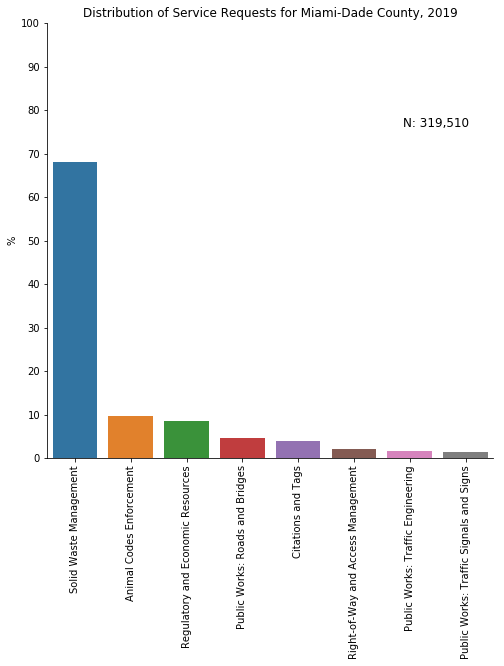

In [120]:
plt.figure(figsize = (8,8))
sns.barplot(x = 'request_types', y = 'request_types', data = mdc, estimator = lambda x: len(x) / len(mdc) * 100 )
plt.ylim(0,100)
plt.xticks(np.arange(8), ('Solid Waste Management', 'Animal Codes Enforcement', 'Regulatory and Economic Resources',
                       'Public Works: Roads and Bridges', 'Citations and Tags', 
                        'Right-of-Way and Access Management', 'Public Works: Traffic Engineering', 
                          'Public Works: Traffic Signals and Signs'), rotation = 90)
plt.xlabel('')
plt.ylabel('%')
plt.yticks(np.arange(0, 110, step = 10))
sns.despine()
plt.title('Distribution of Service Requests for Miami-Dade County, 2019')
plt.figtext(0.8, .7, 'N: 319,510', wrap=True, horizontalalignment='center', fontsize=12)

plt.show()

The strong majority of 311 service requests, almost 70%, are related to waste management and the remaining thirty percent is distributed among animal code enforcement, regulatory and economic resources, public works issues, work on right of way access issues, and pet registration matters (Citations and Tags). 

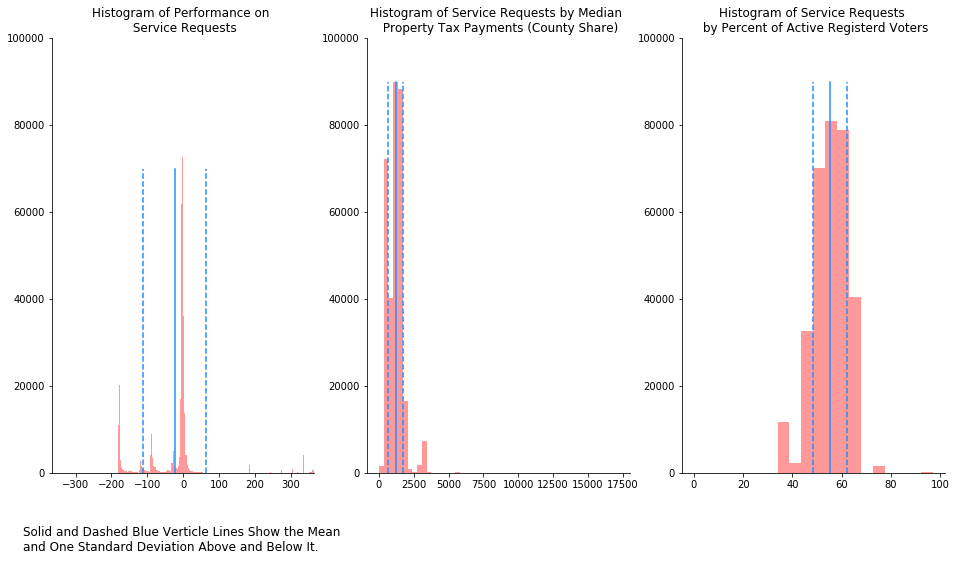

In [121]:
plt.figure(figsize = (16, 8))

plt.subplot(1, 3, 1)
sns.distplot(mdc['performance'], kde = False, bins = 244, color = 'red')
sns.despine()
plt.xlabel('')
plt.ylabel('')
plt.xlim(-366, 366)
plt.ylim(0, 100000)
plt.axvline(mdc['performance'].mean(), color = 'dodgerblue', linestyle = 'solid', ymax = .7)
plt.axvline(mdc['performance'].mean() - mdc['performance'].std(), color = 'dodgerblue', linestyle = 'dashed', ymax = .7)
plt.axvline(mdc['performance'].mean() + mdc['performance'].std(), color = 'dodgerblue', linestyle = 'dashed', ymax = .7)
plt.title("Histogram of Performance on \n Service Requests")

plt.subplot(1, 3, 2)
sns.distplot(mdc['taxzip'], kde = False, color = 'red')
sns.despine()
plt.xlabel('')
plt.ylabel('')
plt.ylim(0, 100000)
plt.axvline(mdc['taxzip'].mean(), color = 'dodgerblue', linestyle = 'solid', ymax = .9)
plt.axvline(mdc['taxzip'].mean() - mdc['taxzip'].std(), color = 'dodgerblue', linestyle = 'dashed', ymax = .9)
plt.axvline(mdc['taxzip'].mean() + mdc['taxzip'].std(), color = 'dodgerblue', linestyle = 'dashed', ymax = .9)
plt.title('Histogram of Service Requests by Median \n Property Tax Payments (County Share)')

plt.subplot(1, 3, 3)
sns.distplot(mdc['active_voters'], kde = False, bins = 20, color = 'red')
sns.despine()
plt.xlabel('')
plt.ylabel('')
plt.ylim(0,100000)
plt.axvline(mdc['active_voters'].mean(), color = 'dodgerblue', linestyle = 'solid', ymax = .9)
plt.axvline(mdc['active_voters'].mean() - mdc['active_voters'].std(), color = 'dodgerblue', linestyle = 'dashed', ymax = .9)
plt.axvline(mdc['active_voters'].mean() + mdc['active_voters'].std(), color = 'dodgerblue', linestyle = 'dashed', ymax = .9)
plt.title('Histogram of Service Requests \n by Percent of Active Registerd Voters' )

plt.figtext(0.1, -.01, 'Solid and Dashed Blue Verticle Lines Show the Mean \n and One Standard Deviation Above and Below It.', wrap=True, horizontalalignment='left', fontsize=12)

plt.show()

The performance histogram shows that a strong majority of the frequencies are falling along the negative part of the x-axis, which means that the county completed most the services before their deadlines. Relatively few took longer. Though, please note that there were a small percentage of requests that were not completed by the end of 2019 (see discussion above). 

Also, almost all service requests were made in areas where the median tax payment for county services in the zip code were less than $2000. The distribution is positively skewed, meaning that a small sliver of requests were made in the wealthiest areas of the county. 

Finally, most requests for services were made in areas where between 40% and 60% of the zip code's population are active registered voters. 

As I have already noted, I suspect that *neighborhood_districts* are referring to school districts since there are 9 labeled categories. There is one category for unlabeled districts and many of those are missing property information. 

In [122]:
def schooldistricts(x):
    if x['neighborhood_district'] == 'District 1':
        return 1
    
    elif x['neighborhood_district'] == 'District 2':
        return 2
    
    elif x['neighborhood_district'] == 'District 3':
        return 3
    
    elif x['neighborhood_district'] == 'District 4':
        return 4
    
    elif x['neighborhood_district'] == 'District 5':
        return 5
    
    elif x['neighborhood_district'] == 'District 6':
        return 6
    
    elif x['neighborhood_district'] == 'District 7':
        return 7
    
    elif x['neighborhood_district'] == 'District 8':
        return 8
    
    elif x['neighborhood_district'] == 'District 9':
        return 9
    
    else:
        return 10

mdc['school_districts'] = mdc.apply(schooldistricts, axis =1)

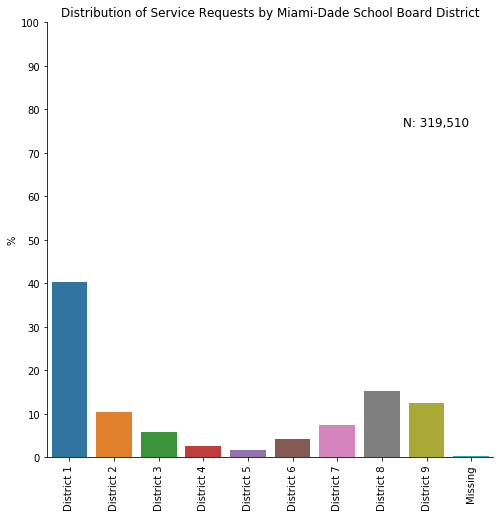

In [123]:
plt.figure(figsize = (8,8))
sns.barplot(x = 'school_districts', y = 'school_districts', data = mdc, estimator = lambda x: len(x) / len(mdc) * 100 )
plt.ylim(0,100)
plt.xticks(np.arange(10), ('District 1', 'District 2', 'District 3', 'District 4', 'District 5',
                           'District 6', 'District 7', 'District 8', 'District 9', 'Missing'), rotation = 90)
plt.xlabel('')
plt.ylabel('%')
plt.yticks(np.arange(0, 110, step = 10))
sns.despine()
plt.title('Distribution of Service Requests by Miami-Dade School Board District')
plt.figtext(0.8, .7, 'N: 319,510', wrap=True, horizontalalignment='center', fontsize=12)

plt.show()

The plurality of service requests were in District 1, which is in the northern part of Miami-Dade. District 2 is just below District 1 and is home to about 10% of all requests. Districts 8 and 9 have the second and third most service requests. Eight is located in the southwest part of the county and 9 has the southern-most part of the county and hugs the coast. 

In [124]:
# Creating a numeric categorical ticket status for a bar plot

def status(x):
    if x['ticket_status'] == 'CLOSED':
        return 0
    elif x['ticket_status'] == 'LOCKED':
        return 1
    elif x['ticket_status'] == 'DUP':
        return 2
    elif x['ticket_status'] == 'WIP':
        return 3
    elif x['ticket_status'] == 'OPEN':
        return 4
    elif x['ticket_status'] == 'CANCEL':
        return 5
    elif x['ticket_status'] == 'LIEN':
        return 6
    else:
        return 7

mdc['request_status'] = mdc.apply(status, axis = 1)

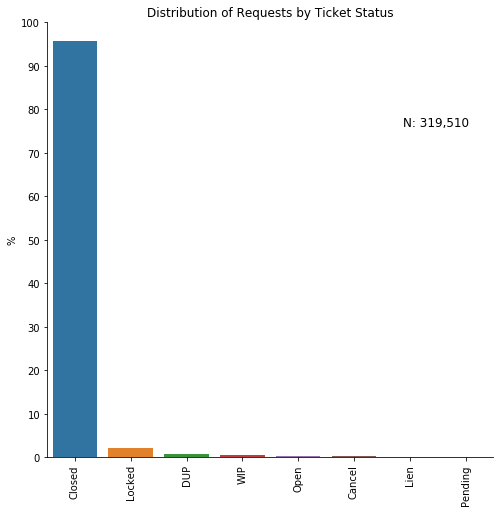

In [125]:
plt.figure(figsize = (8,8))
sns.barplot(x = 'request_status', y = 'request_status', data = mdc, estimator = lambda x: len(x) / len(mdc) * 100 )
plt.ylim(0,100)
plt.xticks(np.arange(8), ('Closed', 'Locked', 'DUP', 'WIP', 'Open', 'Cancel', 'Lien', 'Pending'), rotation = 90)
plt.xlabel('')
plt.ylabel('%')
plt.yticks(np.arange(0, 110, step = 10))
sns.despine()
plt.title('Distribution of Requests by Ticket Status')
plt.figtext(0.8, .7, 'N: 319,510', wrap=True, horizontalalignment='center', fontsize=12)

plt.show()

From looking at the ticket statuses, we can see that the county closed 95% of all requests made in 2019 in the same year. (I assume that closed means that the request was completed.) 

Finally, before we explore the "method received" data visually, we see that there are too many categories to be useful in a visualization. Let's collapse them to make it more manageable. 

In [126]:
def method(x):
    if x['method_received'] == 'PHONE':
        return 0
    
    elif x['method_received'] == 'WEB' or x['method_received'] == 'IPHONE' or x['method_received'] == 'ANDROID':
        return 1
    
    elif x['method_received'] == 'XTERFACE':
        return 2
    
    elif x['method_received'] == 'EMAIL':
        return 3
    
    elif x['method_received'] == 'INHOUSE':
        return 4
    
    elif x['method_received'] == 'WALKIN':
        return 5
    
    elif x['method_received'] == 'PROACT':
        return 6
    
    elif x['method_received'] == 'FAX':
        return 7
    
    else:
        return 8
    
mdc['method'] = mdc.apply(method, axis = 1)

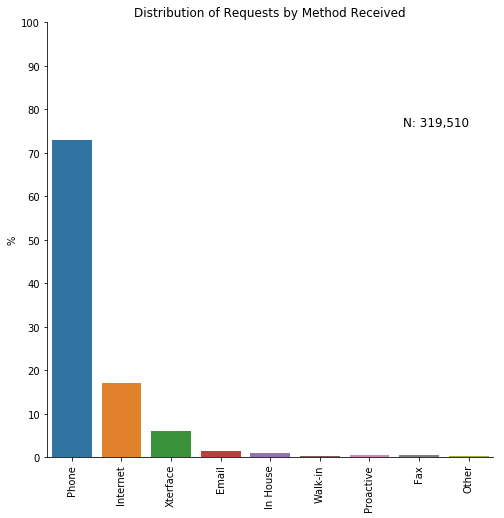

In [127]:
plt.figure(figsize = (8,8))
sns.barplot(x = 'method', y = 'method', data = mdc, estimator = lambda x: len(x) / len(mdc) * 100 )
plt.ylim(0,100)
plt.xticks(np.arange(9), ('Phone', 'Internet', 'Xterface', 'Email', 'In House', 
                         'Walk-in', 'Proactive', 'Fax', 'Other'), rotation = 90)
plt.xlabel('')
plt.ylabel('%')
plt.yticks(np.arange(0, 110, step = 10))
sns.despine()
plt.title('Distribution of Requests by Method Received')
plt.figtext(0.8, .7, 'N: 319,510', wrap=True, horizontalalignment='center', fontsize=12)

plt.show()

Roughly 70% of all requests were made by telephone, while almost 20% came in via a web browser. The remaining 10% were made through a medium called Xterface, email, walk ins, fax, among other ways. (I was unable to find information on what Xterface was and attempts to reach out to the county were unsuccessful). 

### Feature Collinearity

The correlation matrix below shows that collinearity among the features is not a major problem. Tax payments and active voters by zip code are moderately correlated each other, but only at .47. 

In [128]:
features = mdc[['request_types', 'performance', 'taxzip', 'active_voters', 'neighborhood_district', 'method_received', 'request_status']]

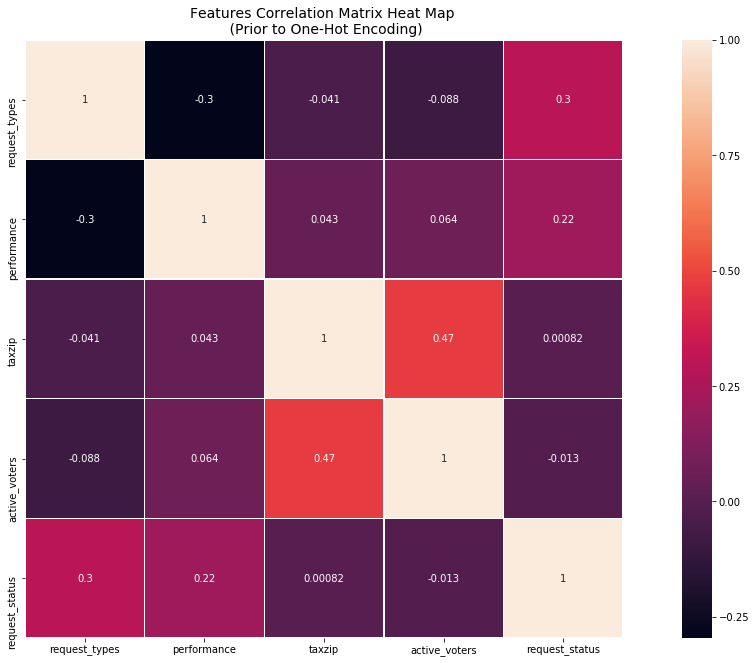

In [129]:
plt.figure(figsize = (21,11))
sns.heatmap(features.corr(method = 'spearman'), square = True, annot = True, linewidths = .5)

plt.title("Features Correlation Matrix Heat Map \n (Prior to One-Hot Encoding)", fontsize=14)

plt.show()

### Outliers

Machine learning algorithms are sensitive to outliers, but at least two of the features have meaningful outliers that I argue should remain as they are in the data. The *performance* feature has many requests that have values of 366 because their tickets were still open as of the end of 2019. Rather than tossing them out, I gave them the value of 366 to incorporate them into the data. The tax payment data, *taxzip* has one or two zip codes that pay much higher property taxes than other zip codes because they are among the wealthiest areas in the United States. They are abnormal, but they are potentially meaningful outliers and I am going to leave them as is. Miami itself is an outlier in measures of economic inequality in the United States, so it is not surprising that we have wide variation in income in the data.

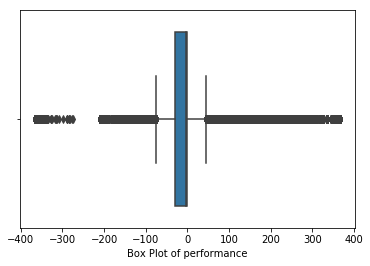

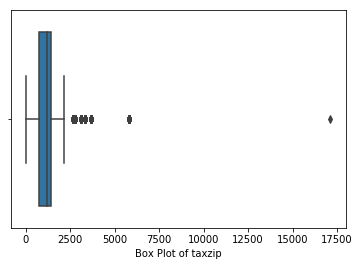

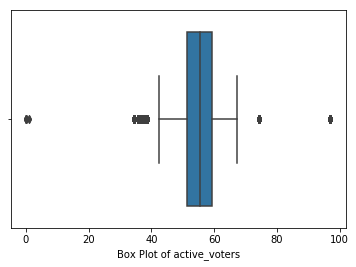

In [130]:
numerics = ['performance', 'taxzip', 'active_voters']

for feature in numerics:
    sns.boxplot(x = feature, data = mdc)
    plt.xlabel('Box Plot of '+ feature)
    plt.show()

The active voters measure has really high and really low values in comparison to the rest of the distribution. The zip codes with really high values are fairly wealthy areas and their values are plausible. The really low value, on the other hand, is abnormally low. I am going to cap it at the 1st percentile. 

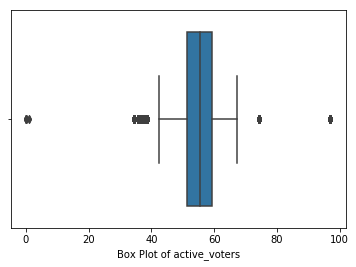

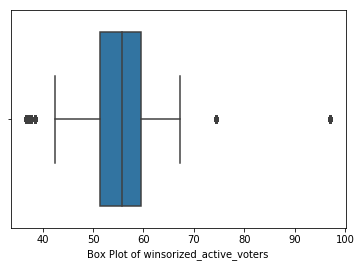

In [131]:
mdc['winsorized_active_voters'] = winsorize(mdc['active_voters'], (0.01, 0.0))

sns.boxplot(x = 'active_voters', data = mdc)
plt.xlabel('Box Plot of active_voters')
plt.show()

sns.boxplot(x = 'winsorized_active_voters', data = mdc)
plt.xlabel('Box Plot of winsorized_active_voters')

plt.show()

In [132]:
mdc.info()

<class 'pandas.core.frame.DataFrame'>
Index: 319519 entries, 19-10000002 to 19-10490440
Data columns (total 32 columns):
issue_type                       319519 non-null object
issue_description                319519 non-null object
case_owner                       319519 non-null object
case_owner_description           319519 non-null object
street_address                   319326 non-null object
city                             319135 non-null object
state                            319326 non-null object
zip_code                         319519 non-null Int64
neighborhood_district            319519 non-null object
created_year_month               319519 non-null int64
ticket_created_date_time         319519 non-null object
ticket__last_update_date_time    319519 non-null object
ticket_closed_date_time          309404 non-null object
ticket_status                    319519 non-null object
location_city                    319519 non-null object
sr_xcoordinate                   318974 n

In [133]:
mdc.neighborhood_district.value_counts()

District 1    129020
District 8     48506
District 9     39950
District 2     32830
District 7     23690
District 3     18537
District 6     13180
District 4      8264
District 5      4994
District         548
Name: neighborhood_district, dtype: int64

### One Hot Encoding The Categorical Variables

We need to convert our categorical variables to dummy variables for each category. We will be using 'neighborhood_district', 'ticket_status', 'method_received', and 'request_types'. Before we move to neighborhood district, we will replace the unlabeled district category from "District " to "District Missing."

In [134]:
# Changing the missing category label on 'neighborhood_district'

mdc.loc[mdc['neighborhood_district'] == 'District ', 'neighborhood_district'] = 'District Missing'

mdc.neighborhood_district.value_counts()

In [135]:
mdc = pd.concat([mdc, pd.get_dummies(mdc['neighborhood_district'], prefix = 'neighborhood', drop_first = True)], axis=1)

In [136]:
mdc.ticket_status.value_counts()

CLOSED    305804
LOCKED      6927
DUP         2346
WIP         1565
OPEN        1306
CANCEL      1244
LIEN         326
PENDNG         1
Name: ticket_status, dtype: int64

In [137]:
mdc = pd.concat([mdc, pd.get_dummies(mdc['ticket_status'], prefix = 'status', drop_first = True)], axis=1)

In [138]:
mdc = pd.concat([mdc, pd.get_dummies(mdc['method'], prefix = 'method', drop_first = True)], axis=1)

In [139]:
mdc = pd.concat([mdc, pd.get_dummies(mdc['request_types'], prefix = 'request', drop_first = True)], axis=1)

In [140]:
mdc.info()

<class 'pandas.core.frame.DataFrame'>
Index: 319519 entries, 19-10000002 to 19-10490440
Data columns (total 63 columns):
issue_type                       319519 non-null object
issue_description                319519 non-null object
case_owner                       319519 non-null object
case_owner_description           319519 non-null object
street_address                   319326 non-null object
city                             319135 non-null object
state                            319326 non-null object
zip_code                         319519 non-null Int64
neighborhood_district            319519 non-null object
created_year_month               319519 non-null int64
ticket_created_date_time         319519 non-null object
ticket__last_update_date_time    319519 non-null object
ticket_closed_date_time          309404 non-null object
ticket_status                    319519 non-null object
location_city                    319519 non-null object
sr_xcoordinate                   318974 n

## Setting the Data and Standardizing It

### Sampling the data

There are over 300,000 rows in the data and that will cause clustering and dimensionality algorithms to take very long times to run. I first attempted to run K-Means and calculating the silhouette score took over 30 minutes to run. Given that I will be tweaking several algorithms and testing their performances, in the interest of efficiency, I will take a random sample of 20% of the data for the analyses. 

I tried to use a sample of 50%, but the algorithms still took very long times to run, especially DBSCAN. It took over an hour for one run and it also caused the kernel to die on many occasions after running for one to two hours. I also attempted to conduct this work on Google Colab, but DBSCAN also caused its kernel to die because I was using more than the alloted RAM. Using a 20% sample allowed me to complete the work in Jupyter notebook without losing progress halfway through. 

In [141]:
mdc_sampled = mdc.sample(frac = 1, random_state = 34)

In [142]:
mdc_sampled = mdc_sampled.sample(frac = .2, random_state = 34)

In [143]:
X = mdc_sampled[['taxzip', 'performance', 'winsorized_active_voters', 'neighborhood_District 2', 'neighborhood_District 3',
         'neighborhood_District 4', 'neighborhood_District 5', 'neighborhood_District 6', 'neighborhood_District 7', 
         'neighborhood_District 8', 'neighborhood_District 9', 'neighborhood_District Missing', 'status_CLOSED',
         'status_DUP', 'status_LIEN', 'status_LOCKED', 'status_OPEN', 'status_PENDNG', 'status_WIP', 'method_1', 
         'method_2', 'method_3', 'method_4', 'method_5', 'method_6', 'method_7', 'method_8', 'request_1', 
         'request_2', 'request_3', 'request_4', 'request_5', 'request_6', 'request_7']]
    
# Standardizing the features

scaler = StandardScaler()
X_std = scaler.fit_transform(X)

To find the optimal number of clusters, I will use the elbow effect to identify the optimal K. For each K, we will run k-means and use the inertia attribute to identify the sum of squared distances of samples to the nearest cluster center. 

In [144]:
Sum_of_squared_distances = []
K = range(1,15)
for k in K:
    km = KMeans(n_clusters=k, random_state = 20)
    km = km.fit(X_std)
    Sum_of_squared_distances.append(km.inertia_)

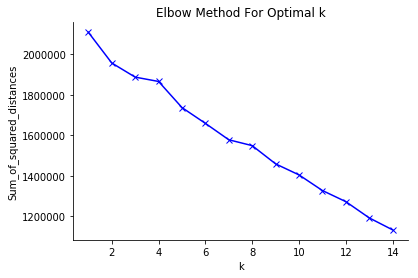

In [145]:
plt.plot(K, Sum_of_squared_distances, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
sns.despine()
plt.show()

The plot shows an elbow at 3, but also another one at 7. The graph is offering a conflicting guidance, so I will calculate Silhouette Score over a range of Ks to find the solution with the best performance. 

In [146]:
### Finding optimal silhouette score

time_start = time.time()

for i in range(2,15):
    labels2 = KMeans(n_clusters = i, random_state = 2).fit_predict(X_std)
    print('Silhouette Score for {}-cluster K-Means: {}'.format(i, metrics.silhouette_score(X_std, labels2, metric='euclidean')))
    
print('Time for Silhouette Score Loop: {} seconds.'.format(time.time()-time_start))    

Silhouette Score for 2-cluster K-Means: 0.5722152146909107
Silhouette Score for 3-cluster K-Means: 0.2950434316748359
Silhouette Score for 4-cluster K-Means: 0.254881204910137
Silhouette Score for 5-cluster K-Means: 0.15976438267469983
Silhouette Score for 6-cluster K-Means: 0.15961795436677434
Silhouette Score for 7-cluster K-Means: 0.33878403811286706
Silhouette Score for 8-cluster K-Means: 0.1559320437346018
Silhouette Score for 9-cluster K-Means: 0.24149721567616492
Silhouette Score for 10-cluster K-Means: 0.2516701910256403
Silhouette Score for 11-cluster K-Means: 0.2662514670597163
Silhouette Score for 12-cluster K-Means: 0.27207379828777806
Silhouette Score for 13-cluster K-Means: 0.21122852611506335
Silhouette Score for 14-cluster K-Means: 0.20469639954286029
Time for Silhouette Score Loop: 935.1468691825867 seconds.


After calculating Silhouette Scores for a range of K values to find an optimal number of clusters, the best solution is two. The score is .57, which indicates that it is far from a random cluster, but not perfectly dense.

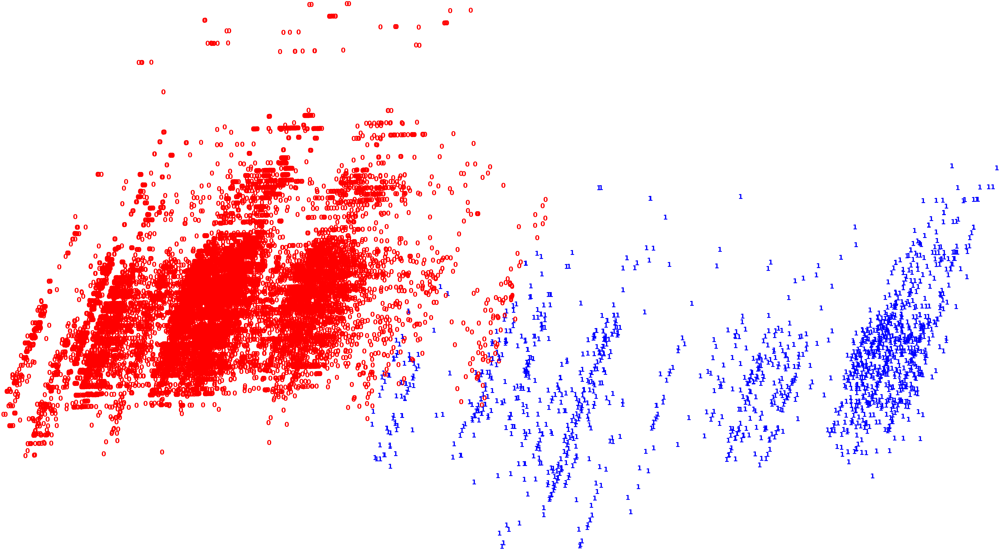

Time for Plot: 187.2807080745697 seconds.


In [147]:
time_start = time.time()

labels = KMeans(n_clusters = 2, random_state = 2).fit_predict(X_std)

pca = PCA(n_components=2).fit_transform(X_std)


plt.figure(figsize = (10,5))
colors = 'rb'
for i in range(pca.shape[0]):
    plt.text(pca[i, 0], pca[i, 1], str(labels[i]),
             color = colors[labels[i]],
             fontdict = {'weight': 'bold', 'size': 50}
            )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

print('Time for Plot: {} seconds.'.format(time.time()-time_start))

Using PCA to reduce the data to two dimensions, we can see two clusters are separated fairly well with little overlap between them. 

In [148]:
time_start = time.time()

for n in (2, 5, 10, 20):
    umap_results = umap.UMAP(n_neighbors=n,
                             min_dist=0.1,
                             n_components = 2,
                             metric='correlation', init = 'random').fit_transform(X_std)
    
    plt.figure(figsize=(10,5))
    colours = ["r","b"]
    for i in range(umap_results.shape[0]):
        plt.text(umap_results[i, 0], umap_results[i, 1], labels[i],
                 color=colours[int(labels[i])],
                 fontdict={'weight': 'bold', 'size': 50}
                )

    plt.xticks([])
    plt.yticks([])
    plt.axis('off')
    plt.title('UMAP with {}-Neighbors'.format(n))
    plt.show()

print('Time for Plots: {} seconds.'.format(time.time()-time_start))

/usr/local/lib/python3.7/site-packages/umap/nndescent.py:92: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../../usr/local/lib/python3.7/site-packages/umap/utils.py", line 409:
@numba.njit(parallel=True)
def build_candidates(current_graph, n_vertices, n_neighbors, max_candidates, rng_state):
^

  current_graph, n_vertices, n_neighbors, max_candidates, rng_state
/usr/local/lib/python3.7/site-packages/numba/typed_passes.py:293: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../../usr/local/lib/pyth

/usr/local/lib/python3.7/site-packages/numba/typed_passes.py:293: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../../usr/local/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  state.func_ir.loc))


/usr/local/lib/python3.7/site-packages/numba/typed_passes.py:293: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../../usr/local/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  state.func_ir.loc))


/usr/local/lib/python3.7/site-packages/numba/typed_passes.py:293: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../../usr/local/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  state.func_ir.loc))


Time for Plots: 1315.9532091617584 seconds.


U-Map does an even worse job of plotting the data in two dimensions than K-Means, regardless of the number of neighbors. DBSCAN and Gaussian Mixture Models may perform better.  

### DBSCAN

DBScan requires us to tune epsilon and the minimum number of samples (neighbors). [A general rule of thumb](https://towardsdatascience.com/how-dbscan-works-and-why-should-i-use-it-443b4a191c80) is that the minimum number of samples should be greater than or equal to the data's dimensions plus 1. There are 34 features being used, so we will use 35 as the minimum number of samples. To find the best epsilon, I will test a range of epsilon values and use the one that has the best Silhouette Score. 

In [149]:
# Tuning epsilon

epsilon = [.2, .4, .6, .8, .1, 2, 3, 4, 5, 6, 7, 8]

for e in epsilon:
    time_start = time.time()
    dbscan_cluster = DBSCAN(eps=e, min_samples=35)
    # Fit model
    clusters = dbscan_cluster.fit_predict(X_std)
    print("The silhoutte score of the DBSCAN Clustering solution with epsilon of {}: {}"
      .format(e, metrics.silhouette_score(X_std, clusters, metric='euclidean')))
    print('Time for Silhouette Score: {} seconds.'.format(time.time()-time_start))

The silhoutte score of the DBSCAN Clustering solution with epsilon of 0.2: 0.412190906642771
Time for Silhouette Score: 520.8363499641418 seconds.
The silhoutte score of the DBSCAN Clustering solution with epsilon of 0.4: 0.3750299455437959
Time for Silhouette Score: 530.7153100967407 seconds.
The silhoutte score of the DBSCAN Clustering solution with epsilon of 0.6: 0.32348336297483754
Time for Silhouette Score: 525.8186690807343 seconds.
The silhoutte score of the DBSCAN Clustering solution with epsilon of 0.8: 0.34053484080336577
Time for Silhouette Score: 512.4325411319733 seconds.
The silhoutte score of the DBSCAN Clustering solution with epsilon of 0.1: 0.3779266179508605
Time for Silhouette Score: 498.47742199897766 seconds.
The silhoutte score of the DBSCAN Clustering solution with epsilon of 2: 0.5009346088184127
Time for Silhouette Score: 526.3784718513489 seconds.
The silhoutte score of the DBSCAN Clustering solution with epsilon of 3: 0.4118920367702593
Time for Silhouette 

The best score was .5 with an epsilon of 2. 

In [150]:
time_start = time.time()
dbscan_cluster = DBSCAN(eps=2, min_samples=35)
clusters = dbscan_cluster.fit_predict(X_std)
print('Time for Silhouette Score: {} seconds.'.format(time.time()-time_start))

Time for Silhouette Score: 420.93406891822815 seconds.


In [151]:
print("Number of clusters when min_samples={} is: {}".format(35, len(np.unique(clusters))))

Number of clusters when min_samples=35 is: 122


In [152]:
len(np.unique(clusters))

122

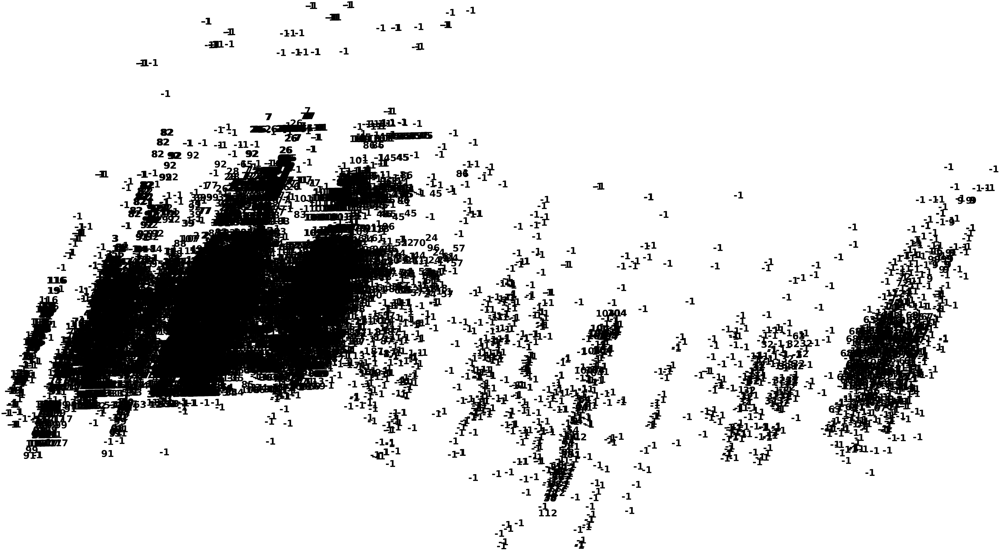

In [153]:
pca = PCA(n_components=2).fit_transform(X_std)

plt.figure(figsize = (10,5))
for i in range(pca.shape[0]):
    plt.text(pca[i, 0], pca[i, 1], str(clusters[i]),
             fontdict = {'weight': 'bold', 'size': 70}
            )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

DBSCAN found 122 clusters, but using PCA we don't see distinct clusters on the left side of the plot, where we see more than several meshed together. I was unable to use a color scheme for that many clusters and left the plot in black and white. Thankfully, the data are structured similarly as they were in the K-means visualization, even though the algorithm identified so many clusters. 

### U-Map

In [154]:
time_start = time.time()


umap_results = umap.UMAP(n_neighbors=15,
                         min_dist=0.1,
                         n_components = 2,
                         metric='correlation').fit_transform(X_std)
    
plt.figure(figsize=(10,5))
for i in range(umap_results.shape[0]):
    plt.text(umap_results[i, 0], umap_results[i, 1], clusters[i],
             fontdict={'weight': 'bold', 'size': 50}
            )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.title('UMAP with {}-Neighbors'.format(n))
plt.show()

print('Time for Plots: {} seconds.'.format(time.time()-time_start))

/usr/local/lib/python3.7/site-packages/numba/typed_passes.py:293: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../../usr/local/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  state.func_ir.loc))
/usr/local/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 1284 separate connected components using meta-embedding (experimental)
  n_components
/usr/local/lib/python3.7/site-packages/umap/spectral.py:182: UserWarning: WARNING: spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  "WARNING: spectral i

Time for Plots: 400.28377985954285 seconds.


PCA does a better job visualizing the data, but with 122 clusters, it does not really matter. I will try a Gaussian Mixture Model to see if it performs more effectively in clustering the data. 

## GMM

In [155]:
time_start = time.time()
covariance = ['full', 'diag', 'tied', 'spherical']

for type in covariance:
    for i in range(2,14):
        # Defining the agglomerative clustering
        gmm_cluster = GaussianMixture(n_components=i, covariance_type = type, random_state=54)
         # Fit model
        clusters = gmm_cluster.fit_predict(X_std)
        print('Silhouette Score for {}-cluster GMM, {} Covariance: {}'.format(i, type, metrics.silhouette_score(X_std, clusters, metric='euclidean')))
    
print('Time for GMM {} Silhouette Score Loop: {} seconds.'.format(i, time.time()-time_start)) 

Silhouette Score for 2-cluster GMM, full Covariance: 0.23701634419937992
Silhouette Score for 3-cluster GMM, full Covariance: 0.24839731366219384
Silhouette Score for 4-cluster GMM, full Covariance: 0.23680822581686298
Silhouette Score for 5-cluster GMM, full Covariance: 0.24551598795977597
Silhouette Score for 6-cluster GMM, full Covariance: 0.21623991725228342
Silhouette Score for 7-cluster GMM, full Covariance: 0.21859710052383313
Silhouette Score for 8-cluster GMM, full Covariance: 0.2270428598123867
Silhouette Score for 9-cluster GMM, full Covariance: 0.2325350840687356
Silhouette Score for 10-cluster GMM, full Covariance: 0.1305289108010387
Silhouette Score for 11-cluster GMM, full Covariance: 0.255799846126333
Silhouette Score for 12-cluster GMM, full Covariance: 0.21255111299410887
Silhouette Score for 13-cluster GMM, full Covariance: 0.22742357108644734
Silhouette Score for 2-cluster GMM, diag Covariance: 0.241254575210521
Silhouette Score for 3-cluster GMM, diag Covariance: 0

The 11 cluster solution using the "tied" type of covariance gave the best performance of .26, which is not very good compared to the other algorithms. 

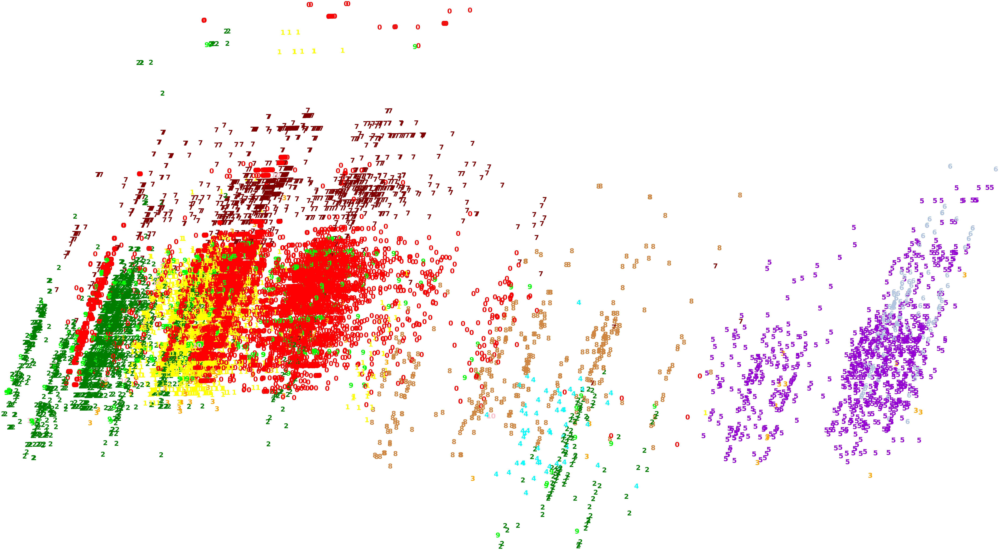

Time for Plot: 174.68604612350464 seconds.


In [156]:
time_start = time.time()

gmm_cluster = GaussianMixture(n_components=11, covariance_type = 'tied', random_state=54)
# Fit model
clusters = gmm_cluster.fit_predict(X_std)

pca = PCA(n_components=2).fit_transform(X_std)

plt.figure(figsize = (10,5))
colors = ['red', 'yellow', 'green', 'orange', 'aqua', 'darkviolet', 'lightsteelblue',
         'maroon', 'peru', 'lime', 'pink']
for i in range(pca.shape[0]):
    plt.text(pca[i, 0], pca[i, 1], str(clusters[i]),
             color = colors[clusters[i]],
             fontdict = {'weight': 'bold', 'size': 50}
            )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

print('Time for Plot: {} seconds.'.format(time.time()-time_start))

We see a lot of overlap between the clusters using PCA. U-MAP has done worse thus far, and I do not expect it to perform better in this context either. 

In [157]:
time_start = time.time()


umap_results = umap.UMAP(n_neighbors=15,
                         min_dist=0.1,
                         n_components = 2,
                         metric='correlation', init = 'random').fit_transform(X_std)
    
plt.figure(figsize=(10,5))
colours = ['red', 'yellow', 'green', 'orange', 'aqua', 'darkviolet', 'lightsteelblue',
         'maroon', 'peru', 'lime', 'pink']
for i in range(umap_results.shape[0]):
    plt.text(umap_results[i, 0], umap_results[i, 1], clusters[i],
             color=colours[int(clusters[i])],
             fontdict={'weight': 'bold', 'size': 50}
                )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.title('UMAP with 15 Neighbors')
plt.show()

print('Time for Plots: {} seconds.'.format(time.time()-time_start))

/usr/local/lib/python3.7/site-packages/numba/typed_passes.py:293: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../../usr/local/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  state.func_ir.loc))


Time for Plots: 331.8278920650482 seconds.


U-Map again fares worse in clustering the data and reducing it to two dimensions than PCA does. 

## K_Means is the Best Performing Algorithm

Using a random sample of 20% of the data, we tested three clustering algorithms to see how well they could group the data, with Silhouette Scores as the evaluating metric. K-Means with a 2 cluster solution achieved the highest score, .57. DBSCAN with an Epsilon of 2 and minimum samples of 35 had a .5, and Gaussian Mixture Models with an 11-cluster solution with a tied covariance type had a .26. The bar graph below plots each score.


In [158]:
results = {
    'scores' : [0.5722152146909107, 0.5009346088184, 0.257843201],
    'algorithms' : ['K-Means', 'DBSCAN', 'GMM'],
    'parameters' : ['2 Clusters', 'Epsilon: 2, Minimum Samples: 35', '11 Clusters, Covariance: Tied']
}

results = pd.DataFrame(results)

In [159]:
results

,scores,algorithms,parameters
0,0.572215,K-Means,2 Clusters
1,0.500935,DBSCAN,"Epsilon: 2, Minimum Samples: 35"
2,0.257843,GMM,"11 Clusters, Covariance: Tied"


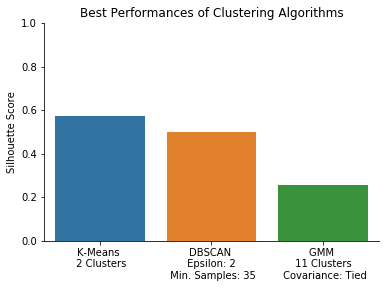

In [160]:
sns.barplot(x = 'algorithms', y = 'scores', data = results)
plt.title("Best Performances of Clustering Algorithms")
plt.ylim(0, 1)
plt.ylabel('Silhouette Score')
plt.xlabel('')
plt.xticks(np.arange(3), ['K-Means \n 2 Clusters', 
                          'DBSCAN \n Epsilon: 2 \n Min. Samples: 35',
                         'GMM \n 11 Clusters \n Covariance: Tied'])

sns.despine()
plt.show()

## Exploring the Clusters

What is left unanswered is what these clusters represent. In this section, I will run the two cluster K-means solution on the whole dataset, add the cluster labels to it, and examine each group in more detail. My suspicion is that the two clusters might represent  a split between the unincorporated areas of the county and incorporated areas, as they each area would, on the whole, demand different portfolios of services from the county. But, I will admit, this is not a strong hunch. 

In [161]:
X = mdc[['taxzip', 'performance', 'winsorized_active_voters', 'neighborhood_District 2', 'neighborhood_District 3',
         'neighborhood_District 4', 'neighborhood_District 5', 'neighborhood_District 6', 'neighborhood_District 7', 
         'neighborhood_District 8', 'neighborhood_District 9', 'neighborhood_District Missing', 'status_CLOSED',
         'status_DUP', 'status_LIEN', 'status_LOCKED', 'status_OPEN', 'status_PENDNG', 'status_WIP', 'method_1', 
         'method_2', 'method_3', 'method_4', 'method_5', 'method_6', 'method_7', 'method_8', 'request_1', 
         'request_2', 'request_3', 'request_4', 'request_5', 'request_6', 'request_7']]
    
# Standardizing the features

scaler = StandardScaler()
X_std = scaler.fit_transform(X)

In [162]:
time_start = time.time()


kmlabels = KMeans(n_clusters = 2, random_state = 2, n_jobs = -1).fit_predict(X_std)
print('Silhouette Score for 2-cluster K-Means: {}'.format(metrics.silhouette_score(X_std, kmlabels, metric='euclidean', n_jobs = -1)))
    
print('Time for Silhouette Score Loop: {} seconds.'.format(time.time()-time_start))

Silhouette Score for 2-cluster K-Means: 0.4214063267930173
Time for Silhouette Score Loop: 3741.7748329639435 seconds.


In [191]:
time_start = time.time()
pca = PCA(n_components=2).fit_transform(X_std)


plt.figure(figsize = (10,5))
colors = 'rb'
for i in range(pca.shape[0]):
    plt.text(pca[i, 0], pca[i, 1], str(kmlabels[i]),
             color = colors[kmlabels[i]],
             fontdict = {'weight': 'bold', 'size': 50}
            )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

print('Time for Plot: {} seconds.'.format(time.time()-time_start))

Time for Plot: 980.9678571224213 seconds.


With the full dataset, K-Means's two cluster solution does a reasonably good job classifying the data, but there is noticeable overlap between the two classes on the left-hand side of the plot. The Silhouette Score is .42, which tells us that the clusters are not randomly formed, but they are also not perfectly dense either. U-Map has done a poor job on the data in every previous iteration and it is also hogging a lot of memory on the file. So, I will forego using it here. 

In [163]:
mdc['kmlabels'] = kmlabels

In [164]:
mdc['kmlabels'].value_counts()

1    289010
0     30509
Name: kmlabels, dtype: int64

In [165]:
mdc.head()

,issue_type,issue_description,case_owner,case_owner_description,street_address,city,state,zip_code,neighborhood_district,created_year_month,...,method_7,method_8,request_1,request_2,request_3,request_4,request_5,request_6,request_7,kmlabels
ticket_id,,,,,,,,,,,,,,,,,,,,,
19-10000002,INJURED ANIMAL,,Enforcement_Section-3-36,Enforcement_Section-3-36,510 NE 159TH ST,Miami_Dade_County,Florida,33162,District 2,20191,...,0,0,1,0,0,0,0,0,0,1
19-10000215,BULKY TRASH REQUEST,,Solid_Waste_Management,Solid Waste Management,26411 SW 134TH PL,Miami_Dade_County,Florida,33032,District 9,20191,...,0,0,0,0,0,0,0,0,0,1
19-10000004,ASU POLICE ASSISTANCE,,Enforcement_Section-3-36,Enforcement_Section-3-36,SW 194TH TER & SW 87TH AVE,Town_of_Cutler_Bay,Florida,33157,District 8,20191,...,0,0,1,0,0,0,0,0,0,1
19-10000216,GARBAGE COMPLAINT,,Solid_Waste_Management,Solid Waste Management,9130 SW 177TH TER,City_of_Palmetto_Bay,Florida,33157,District 8,20191,...,0,0,0,0,0,0,0,0,0,1
19-10000228,COMMERCIAL VEHICLE - UNAUTHORIZED,,Regulatory_and_Economic_Resources,Regulatory and Economic Resources,3401 NW 110TH ST,Miami_Dade_County,Florida,33167,District 2,20191,...,0,0,0,1,0,0,0,0,0,0


In [166]:
mdc[mdc['kmlabels'] == 1].taxzip.describe()

count    289010.000000
mean       1203.889962
std         555.745566
min           0.000000
25%         718.773905
50%        1210.378369
75%        1438.696704
max       17125.009885
Name: taxzip, dtype: float64

In [167]:
mdc[mdc['kmlabels'] == 0].taxzip.describe()

count    30509.000000
mean      1183.031711
std        508.325424
min        230.097147
25%        718.773905
50%       1210.378369
75%       1438.696704
max       5776.128721
Name: taxzip, dtype: float64

In [168]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Index: 319519 entries, 19-10000002 to 19-10490440
Data columns (total 34 columns):
taxzip                           319519 non-null float64
performance                      319519 non-null float64
winsorized_active_voters         319519 non-null float64
neighborhood_District 2          319519 non-null uint8
neighborhood_District 3          319519 non-null uint8
neighborhood_District 4          319519 non-null uint8
neighborhood_District 5          319519 non-null uint8
neighborhood_District 6          319519 non-null uint8
neighborhood_District 7          319519 non-null uint8
neighborhood_District 8          319519 non-null uint8
neighborhood_District 9          319519 non-null uint8
neighborhood_District Missing    319519 non-null uint8
status_CLOSED                    319519 non-null uint8
status_DUP                       319519 non-null uint8
status_LIEN                      319519 non-null uint8
status_LOCKED                    319519 non-null

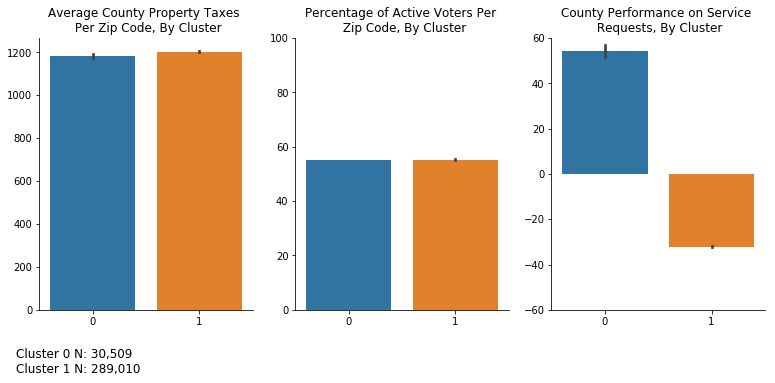

In [180]:
plt.figure(figsize = (13, 5))
#plt.subplots_adjust(hspace = .1)

plt.subplot(1, 3, 1)
sns.barplot(x = 'kmlabels', y = 'taxzip', data = mdc, ci = 99)
plt.title('Average County Property Taxes \n Per Zip Code, By Cluster')
plt.ylabel('')
plt.xlabel('')
plt.figtext(.1, -.05, 'Cluster 0 N: 30,509 \nCluster 1 N: 289,010', fontsize = 12)
sns.despine()
 

plt.subplot(1, 3, 2)
sns.barplot(x = 'kmlabels', y = 'winsorized_active_voters', data = mdc, ci = 99)
plt.title('Percentage of Active Voters Per \n Zip Code, By Cluster')
plt.ylabel('')
plt.ylim(0, 100)
plt.xlabel('')
sns.despine()
 

plt.subplot(1, 3, 3)
sns.barplot(x = 'kmlabels', y = 'performance', data = mdc, ci = 99)
plt.title('County Performance on Service \n Requests, By Cluster')
plt.ylabel('')
plt.ylim(-60, 60)
plt.xlabel('')
sns.despine()


plt.show()



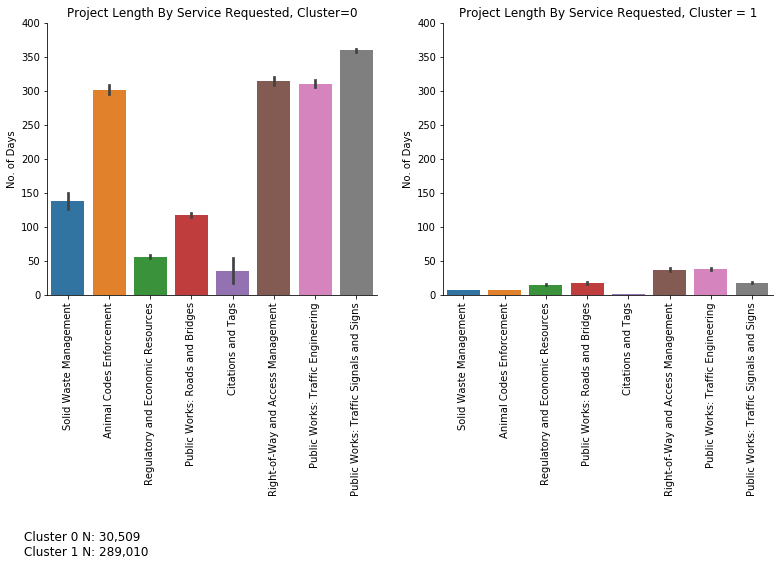

In [195]:
plt.figure(figsize = (13, 5))

plt.subplot(1, 2, 1)
sns.barplot(x = 'request_types', y = 'actual_completed_days', data = mdc[mdc['kmlabels'] == 0])
plt.title('Project Length By Service Requested, Cluster=0')
plt.ylabel('No. of Days')
plt.xlabel('')
plt.ylim(0, 400)
plt.xticks(np.arange(8), ('Solid Waste Management', 
                          'Animal Codes Enforcement', 
                          'Regulatory and Economic Resources', 
                          'Public Works: Roads and Bridges', 
                          'Citations and Tags', 
                          'Right-of-Way and Access Management', 
                          'Public Works: Traffic Engineering', 
                          'Public Works: Traffic Signals and Signs'), rotation = 90)
sns.despine()
plt.figtext(.1, - .6, 'Cluster 0 N: 30,509 \nCluster 1 N: 289,010', fontsize = 12)




plt.subplot(1, 2, 2)
sns.barplot(x = 'request_types', y = 'actual_completed_days', data = mdc[mdc['kmlabels'] == 1])
plt.title('Project Length By Service Requested, Cluster = 1')
plt.ylabel('No. of Days')
plt.xlabel('')
plt.ylim(0, 400)
plt.xticks(np.arange(8), ('Solid Waste Management', 
                          'Animal Codes Enforcement', 
                          'Regulatory and Economic Resources', 
                          'Public Works: Roads and Bridges', 
                          'Citations and Tags', 
                          'Right-of-Way and Access Management', 
                          'Public Works: Traffic Engineering', 
                          'Public Works: Traffic Signals and Signs'), rotation = 90)
sns.despine()


plt.show()

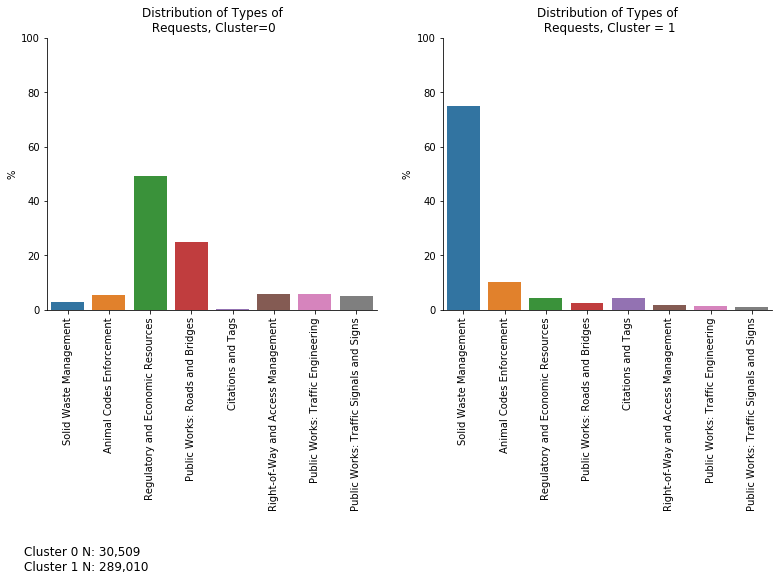

In [196]:
plt.figure(figsize = (13, 5))

plt.subplot(1, 2, 1)
sns.barplot(x = 'request_types', y = 'request_types', data = mdc[mdc['kmlabels'] == 0], 
            estimator = lambda x: len(x) / len(mdc[mdc['kmlabels'] == 0]) * 100)
plt.title('Distribution of Types of\n Requests, Cluster=0')
plt.ylabel('%')
plt.xlabel('')
plt.ylim(0, 100)
plt.xticks(np.arange(8), ('Solid Waste Management', 
                          'Animal Codes Enforcement', 
                          'Regulatory and Economic Resources', 
                          'Public Works: Roads and Bridges', 
                          'Citations and Tags', 
                          'Right-of-Way and Access Management', 
                          'Public Works: Traffic Engineering', 
                          'Public Works: Traffic Signals and Signs'), rotation = 90)
sns.despine()
plt.figtext(.1, - .6, 'Cluster 0 N: 30,509 \nCluster 1 N: 289,010', fontsize = 12)




plt.subplot(1, 2, 2)
sns.barplot(x = 'request_types', y = 'request_types', data = mdc[mdc['kmlabels'] == 1], 
            estimator = lambda x: len(x) / len(mdc[mdc['kmlabels'] == 1]) * 100)
plt.title('Distribution of Types of\n Requests, Cluster = 1')
plt.ylabel('%')
plt.xlabel('')
plt.ylim(0, 100)
plt.xticks(np.arange(8), ('Solid Waste Management', 
                          'Animal Codes Enforcement', 
                          'Regulatory and Economic Resources', 
                          'Public Works: Roads and Bridges', 
                          'Citations and Tags', 
                          'Right-of-Way and Access Management', 
                          'Public Works: Traffic Engineering', 
                          'Public Works: Traffic Signals and Signs'), rotation = 90)
sns.despine()


plt.show()

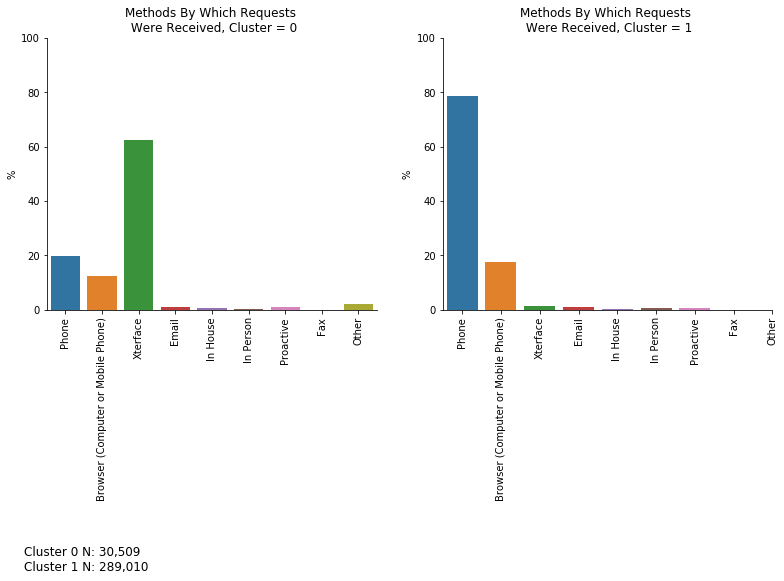

In [197]:
plt.figure(figsize = (13, 5))

plt.subplot(1, 2, 1)
sns.barplot(x = 'method', y = 'method', data = mdc[mdc['kmlabels'] == 0], 
            estimator = lambda x: len(x) / len(mdc[mdc['kmlabels'] == 0]) * 100)
plt.title('Methods By Which Requests \n Were Received, Cluster = 0')
plt.ylabel('%')
plt.xlabel('')
plt.ylim(0, 100)
plt.xticks(np.arange(9), ('Phone', 
                          'Browser (Computer or Mobile Phone)', 
                          'Xterface', 
                          'Email', 
                          'In House', 
                          'In Person', 
                          'Proactive', 
                          'Fax',
                         'Other'), rotation = 90)
plt.figtext(.1, - .6, 'Cluster 0 N: 30,509 \nCluster 1 N: 289,010', fontsize = 12)

sns.despine()

plt.subplot(1, 2, 2)
sns.barplot(x = 'method', y = 'method', data = mdc[mdc['kmlabels'] == 1], 
            estimator = lambda x: len(x) / len(mdc[mdc['kmlabels'] == 1]) * 100)
plt.title('Methods By Which Requests \n Were Received, Cluster = 1')
plt.ylabel('%')
plt.xlabel('')
plt.ylim(0, 100)
plt.xticks(np.arange(9), ('Phone', 
                          'Browser (Computer or Mobile Phone)', 
                          'Xterface', 
                          'Email', 
                          'In House', 
                          'In Person', 
                          'Proactive', 
                          'Fax',
                         'Other'), rotation = 90)
sns.despine()

plt.show()

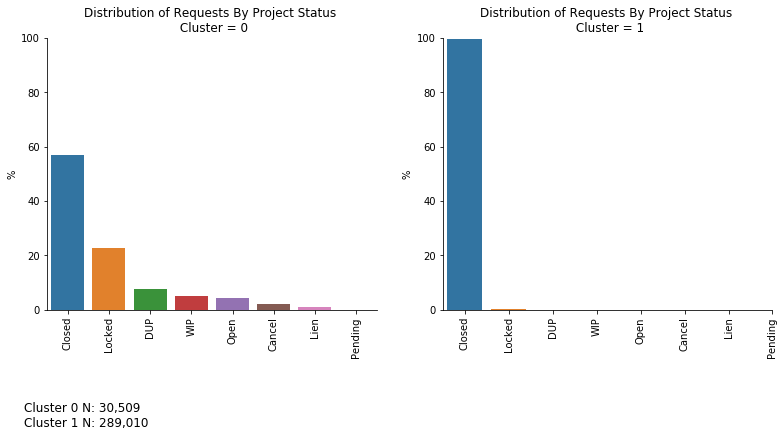

In [201]:
plt.figure(figsize = (13, 5))

plt.subplot(1, 2, 1)
sns.barplot(x = 'request_status', y = 'request_status', data = mdc[mdc['kmlabels'] == 0], 
            estimator = lambda x: len(x) / len(mdc[mdc['kmlabels'] == 0]) * 100)
plt.title('Distribution of Requests By Project Status \n Cluster = 0')
plt.ylabel('%')
plt.xlabel('')
plt.ylim(0, 100)
plt.xticks(np.arange(8), ('Closed', 
                          'Locked', 
                          'DUP', 
                          'WIP', 
                          'Open', 
                          'Cancel', 
                          'Lien', 
                          'Pending'), rotation = 90)
plt.figtext(.1, - .2, 'Cluster 0 N: 30,509 \nCluster 1 N: 289,010', fontsize = 12)

sns.despine()

plt.subplot(1, 2, 2)

sns.barplot(x = 'request_status', y = 'request_status', data = mdc[mdc['kmlabels'] == 1], 
            estimator = lambda x: len(x) / len(mdc[mdc['kmlabels'] == 1]) * 100)
plt.title('Distribution of Requests By Project Status \n Cluster = 1')
plt.ylabel('%')
plt.xlabel('')
plt.ylim(0, 100)
plt.xticks(np.arange(8), ('Closed', 
                          'Locked', 
                          'DUP', 
                          'WIP', 
                          'Open', 
                          'Cancel', 
                          'Lien', 
                          'Pending'), rotation = 90)
sns.despine()

plt.show()

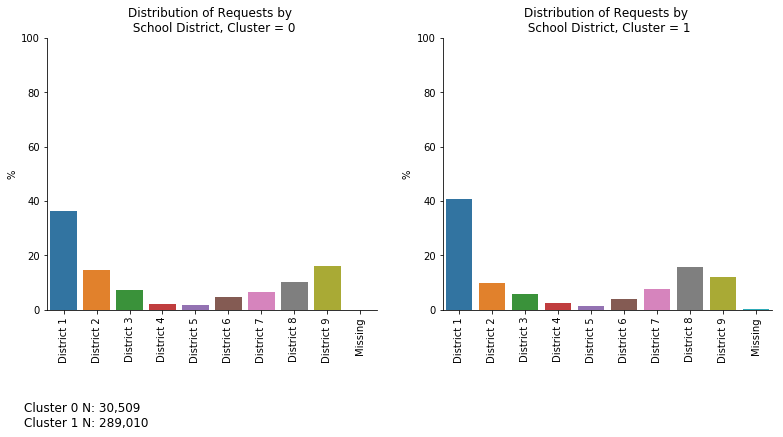

In [199]:
plt.figure(figsize = (13, 5))

plt.subplot(1, 2, 1)
sns.barplot(x = 'school_districts', y = 'school_districts', data = mdc[mdc['kmlabels'] == 0], 
            estimator = lambda x: len(x) / len(mdc[mdc['kmlabels'] == 0]) * 100)
plt.title('Distribution of Requests by \n School District, Cluster = 0')
plt.ylabel('%')
plt.xlabel('')
plt.ylim(0, 100)
plt.xticks(np.arange(10), ('District 1', 
                          'District 2', 
                          'District 3', 
                          'District 4', 
                          'District 5', 
                          'District 6', 
                          'District 7', 
                          'District 8',
                          'District 9',
                          'Missing'), rotation = 90)
sns.despine()
plt.figtext(.1, - .2, 'Cluster 0 N: 30,509 \nCluster 1 N: 289,010', fontsize = 12)



plt.subplot(1, 2, 2)

sns.barplot(x = 'school_districts', y = 'school_districts', data = mdc[mdc['kmlabels'] == 1], 
            estimator = lambda x: len(x) / len(mdc[mdc['kmlabels'] == 1]) * 100)
plt.title('Distribution of Requests by \n School District, Cluster = 1')
plt.ylabel('%')
plt.xlabel('')
plt.ylim(0, 100)
plt.xticks(np.arange(10), ('District 1', 
                          'District 2', 
                          'District 3', 
                          'District 4', 
                          'District 5', 
                          'District 6', 
                          'District 7', 
                          'District 8',
                          'District 9',
                          'Missing'), rotation = 90)
sns.despine()

## Service requests in Miami-Dade County Are Clustered Into Major Projects and Minor Projects.

The two clusters appear to be divided by magnitude of time and resources that the task requires. Cluster 1, as explained below, is populated with service requests that took relatively little time to complete. Cluster 0, on the other, tends to have projects that took longer to complete than the county anticipated, possibly because they require greater amounts of resources than most other projects. 

Cluster 1 contains 90 percent of the service requests and they seem to be relatively minor. The county meets those requests quickly, mostly because they are tasks that can be done in a short amount of time. The *performance* feature, which measures the number days for the project, under or over the target value, has a negative mean for Cluster 1. This means that, on average, the county completes them before their internal deadlines. In fact, one of the above plots shows that 100% of the requests in Cluster One were completed in the same calendar year. Most of the requests were received by telephone (almost 80%). Most of the projects are  Solid Waste Management cases (close to 70%), with the remaining cases including animal code enforcement issues (roughly 10%), pet tag requests (Citations and Tags), and others. If you look at the distribution of issue types for each *case_owner* in the sections above, the specific requests are items that the government has the supplies on hand and can employ them immediately, or they do not require departments and their employees to utilize a lot of resources. Nor are many of these items projects that require a long bureaucratic process. 

Cluster 0, on the other hand, includes only 9 percent of the requests, but they are major projects that likely require much greater resources. They also take considerably more time to complete. The mean for *performance* in Cluster 0 is greater than 50, which means that the average project took more than fifty days longer than the county's goal. Less than 60% of the projects in the cluster were completed by the end of 2019. The caseload includes a mix of projects that governments typically are slow to get to and even slower to complete. Half of the cluster's requests were regulatory or economic enforcement requests, but almost as many were public works projects, which citizens constantly complain about over how long they take. Public Works projects may require zoning changes that require new ordinances, environmental impact studies, or a bureaucratic procedures to oversee competitive bidding processes. Cluster 0 also has animal code enforcement requests, which the plots above show that they averaged about 300 days to complete. Animal services code enforcement divisions are typically underfunded and it is possible that the county received more requests than their staff could handle. Or, there may be other details that lead officers to spend a lot of time working to service the requests. 

While these clusters seem like they are distinct, there are a number of questions surrounding the county's service requests that have yet to be answered by the data. Requests in Cluster 0 tend to come in through different means than requests in Cluster One: Xterface in 0 vs. mostly by phone in 1. It would be interesting to explore why projects that take longer and may require more time and resources are submitted through different methods than "minor" projects. Perhaps there are ways to streamline the process to reduce the amount of time that it takes to complete them. We may also be missing other important data about the nature of service requests that would shed more light on why some items take longer than others. While I attempted to control for geography, I am still left wondering if requests and time to completion are stratified by location and whether there is more left to be uncovered. In my next steps I would try to integrate other features that would help me get more leverage over these questions and help me break down some of the differences between the clusters to even greater degrees. 